# Afriat

In [1]:
scan=0.4

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: edhlf9g5
Name: copper-donkey-116
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/edhlf9g5
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_112321-edhlf9g5/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2580,3260,9403
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2580,2557,1693,3459,1632,3322
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4489,10754
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 625,849,2336
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 625,645,415,831,417,877
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1095,2715
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:12<2:01:56, 12.21s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:12<2:01:56, 12.21s/it, v_num=g5_1, total_loss_train=3.72e+3, kl_local_train=46.1]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:12<2:01:56, 12.21s/it, v_num=g5_1, total_loss_train=3.72e+3, kl_local_train=46.1]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:19<1:35:39,  9.60s/it, v_num=g5_1, total_loss_train=3.72e+3, kl_local_train=46.1]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:19<1:35:39,  9.60s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=60.1]

Epoch 3/600:   0%|▌                                                                                                                                                       | 2/600 [00:19<1:35:39,  9.60s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=60.1]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:27<1:27:01,  8.75s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=60.1]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:27<1:27:01,  8.75s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=59.2]

Epoch 4/600:   0%|▊                                                                                                                                                       | 3/600 [00:27<1:27:01,  8.75s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=59.2]

Epoch 4/600:   1%|█                                                                                                                                                       | 4/600 [00:35<1:22:48,  8.34s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=59.2]

Epoch 4/600:   1%|█                                                                                                                                                         | 4/600 [00:35<1:22:48,  8.34s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=56]

Epoch 5/600:   1%|█                                                                                                                                                         | 4/600 [00:35<1:22:48,  8.34s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=56]

Epoch 5/600:   1%|█▎                                                                                                                                                        | 5/600 [00:43<1:20:24,  8.11s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=56]

Epoch 5/600:   1%|█▎                                                                                                                                                      | 5/600 [00:43<1:20:24,  8.11s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=50.9]

Epoch 6/600:   1%|█▎                                                                                                                                                      | 5/600 [00:44<1:20:24,  8.11s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=50.9]

Epoch 6/600:   1%|█▌                                                                                                                                                      | 6/600 [00:52<1:23:50,  8.47s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=50.9]

Epoch 6/600:   1%|▏                    | 6/600 [00:52<1:23:50,  8.47s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▏                    | 6/600 [00:52<1:23:50,  8.47s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▏                    | 7/600 [01:00<1:21:17,  8.23s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▏                    | 7/600 [01:00<1:21:17,  8.23s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=35.1, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏                    | 7/600 [01:00<1:21:17,  8.23s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=35.1, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                    | 8/600 [01:07<1:19:25,  8.05s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=35.1, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                   | 8/600 [01:07<1:19:25,  8.05s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=23.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▎                   | 8/600 [01:07<1:19:25,  8.05s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=23.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▎                   | 9/600 [01:15<1:18:11,  7.94s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=23.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▎                    | 9/600 [01:15<1:18:11,  7.94s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=21.2, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                   | 9/600 [01:15<1:18:11,  7.94s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=21.2, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                  | 10/600 [01:23<1:17:26,  7.88s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=21.2, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                 | 10/600 [01:23<1:17:26,  7.88s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=30.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▎                 | 10/600 [01:24<1:17:26,  7.88s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=30.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▎                 | 11/600 [01:32<1:21:15,  8.28s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=30.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00743, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▍                     | 11/600 [01:32<1:21:15,  8.28s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=47.7, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 12/600:   2%|▍                     | 11/600 [01:32<1:21:15,  8.28s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=47.7, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 12/600:   2%|▍                     | 12/600 [01:40<1:19:36,  8.12s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=47.7, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 12/600:   2%|▍                     | 12/600 [01:40<1:19:36,  8.12s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=68.1, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 13/600:   2%|▍                     | 12/600 [01:40<1:19:36,  8.12s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=68.1, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 13/600:   2%|▍                     | 13/600 [01:47<1:18:24,  8.01s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=68.1, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 13/600:   2%|▍                     | 13/600 [01:47<1:18:24,  8.01s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=81.5, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 14/600:   2%|▍                     | 13/600 [01:47<1:18:24,  8.01s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=81.5, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 14/600:   2%|▌                     | 14/600 [01:55<1:17:36,  7.95s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=81.5, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 14/600:   2%|▌                      | 14/600 [01:55<1:17:36,  7.95s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 15/600:   2%|▌                      | 14/600 [01:55<1:17:36,  7.95s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 15/600:   2%|▌                      | 15/600 [02:03<1:16:46,  7.87s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 15/600:   2%|▌                      | 15/600 [02:03<1:16:46,  7.87s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=134, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 16/600:   2%|▌                      | 15/600 [02:04<1:16:46,  7.87s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=134, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 16/600:   3%|▌                      | 16/600 [02:12<1:20:23,  8.26s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=134, metric_mi|status_control_train=0.023, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.02, metric_mi|mouse_train=0.0434]

Epoch 16/600:   3%|▌                   | 16/600 [02:12<1:20:23,  8.26s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=163, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 17/600:   3%|▌                   | 16/600 [02:12<1:20:23,  8.26s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=163, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 17/600:   3%|▌                   | 17/600 [02:20<1:18:31,  8.08s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=163, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 17/600:   3%|▌                   | 17/600 [02:20<1:18:31,  8.08s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=171, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 18/600:   3%|▌                   | 17/600 [02:20<1:18:31,  8.08s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=171, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 18/600:   3%|▌                   | 18/600 [02:27<1:17:30,  7.99s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=171, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 18/600:   3%|▌                   | 18/600 [02:27<1:17:30,  7.99s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=165, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 19/600:   3%|▌                   | 18/600 [02:27<1:17:30,  7.99s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=165, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 19/600:   3%|▋                   | 19/600 [02:35<1:16:37,  7.91s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=165, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 19/600:   3%|▋                   | 19/600 [02:35<1:16:37,  7.91s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=145, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 20/600:   3%|▋                   | 19/600 [02:35<1:16:37,  7.91s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=145, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 20/600:   3%|▋                   | 20/600 [02:43<1:16:12,  7.88s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=145, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 20/600:   3%|▋                   | 20/600 [02:43<1:16:12,  7.88s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=140, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 21/600:   3%|▋                   | 20/600 [02:44<1:16:12,  7.88s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=140, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 21/600:   4%|▋                   | 21/600 [02:52<1:20:12,  8.31s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=140, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0967]

Epoch 21/600:   4%|▉                        | 21/600 [02:52<1:20:12,  8.31s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=136, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 22/600:   4%|▉                        | 21/600 [02:52<1:20:12,  8.31s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=136, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 22/600:   4%|▉                        | 22/600 [03:00<1:18:15,  8.12s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=136, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 22/600:   4%|▉                        | 22/600 [03:00<1:18:15,  8.12s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=136, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 23/600:   4%|▉                        | 22/600 [03:00<1:18:15,  8.12s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=136, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 23/600:   4%|▉                        | 23/600 [03:08<1:17:03,  8.01s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=136, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 23/600:   4%|▉                        | 23/600 [03:08<1:17:03,  8.01s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=137, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 24/600:   4%|▉                        | 23/600 [03:08<1:17:03,  8.01s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=137, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 24/600:   4%|█                        | 24/600 [03:15<1:16:11,  7.94s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=137, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 24/600:   4%|█                        | 24/600 [03:16<1:16:11,  7.94s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=143, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 25/600:   4%|█                        | 24/600 [03:16<1:16:11,  7.94s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=143, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 25/600:   4%|█                        | 25/600 [03:23<1:15:17,  7.86s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=143, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 25/600:   4%|█                        | 25/600 [03:23<1:15:17,  7.86s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=147, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 26/600:   4%|█                        | 25/600 [03:25<1:15:17,  7.86s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=147, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 26/600:   4%|█                        | 26/600 [03:32<1:18:25,  8.20s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=147, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 26/600:   4%|█                       | 26/600 [03:32<1:18:25,  8.20s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=150, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 27/600:   4%|█                       | 26/600 [03:32<1:18:25,  8.20s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=150, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 27/600:   4%|█                       | 27/600 [03:40<1:17:03,  8.07s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=150, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 27/600:   4%|█                       | 27/600 [03:40<1:17:03,  8.07s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=150, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 28/600:   4%|█                       | 27/600 [03:40<1:17:03,  8.07s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=150, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 28/600:   5%|█                       | 28/600 [03:48<1:15:44,  7.94s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=150, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 28/600:   5%|█                       | 28/600 [03:48<1:15:44,  7.94s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 29/600:   5%|█                       | 28/600 [03:48<1:15:44,  7.94s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 29/600:   5%|█▏                      | 29/600 [03:55<1:14:43,  7.85s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 29/600:   5%|█▏                      | 29/600 [03:55<1:14:43,  7.85s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=148, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 30/600:   5%|█▏                      | 29/600 [03:55<1:14:43,  7.85s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=148, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 30/600:   5%|█▏                      | 30/600 [04:03<1:13:59,  7.79s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=148, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 30/600:   5%|█▏                      | 30/600 [04:03<1:13:59,  7.79s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=149, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 31/600:   5%|█▏                      | 30/600 [04:04<1:13:59,  7.79s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=149, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 31/600:   5%|█▏                      | 31/600 [04:12<1:17:41,  8.19s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=149, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 31/600:   5%|█▏                      | 31/600 [04:12<1:17:41,  8.19s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=148, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 32/600:   5%|█▏                      | 31/600 [04:12<1:17:41,  8.19s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=148, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 32/600:   5%|█▎                      | 32/600 [04:20<1:16:09,  8.04s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=148, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 32/600:   5%|█▎                      | 32/600 [04:20<1:16:09,  8.04s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 33/600:   5%|█▎                      | 32/600 [04:20<1:16:09,  8.04s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 33/600:   6%|█▎                      | 33/600 [04:27<1:15:01,  7.94s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 33/600:   6%|█▎                      | 33/600 [04:27<1:15:01,  7.94s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 34/600:   6%|█▎                      | 33/600 [04:27<1:15:01,  7.94s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 34/600:   6%|█▎                      | 34/600 [04:35<1:14:14,  7.87s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 34/600:   6%|█▎                      | 34/600 [04:35<1:14:14,  7.87s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 35/600:   6%|█▎                      | 34/600 [04:35<1:14:14,  7.87s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 35/600:   6%|█▍                      | 35/600 [04:43<1:13:57,  7.85s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 35/600:   6%|█▍                      | 35/600 [04:43<1:13:57,  7.85s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=149, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 36/600:   6%|█▍                      | 35/600 [04:44<1:13:57,  7.85s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=149, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 36/600:   6%|█▍                      | 36/600 [04:52<1:17:38,  8.26s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=149, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 36/600:   6%|█▌                       | 36/600 [04:52<1:17:38,  8.26s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=148, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 37/600:   6%|█▌                       | 36/600 [04:52<1:17:38,  8.26s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=148, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 37/600:   6%|█▌                       | 37/600 [05:00<1:16:16,  8.13s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=148, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 37/600:   6%|█▌                       | 37/600 [05:00<1:16:16,  8.13s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 38/600:   6%|█▌                       | 37/600 [05:00<1:16:16,  8.13s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 38/600:   6%|█▌                       | 38/600 [05:08<1:15:03,  8.01s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 38/600:   6%|█▌                       | 38/600 [05:08<1:15:03,  8.01s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 39/600:   6%|█▌                       | 38/600 [05:08<1:15:03,  8.01s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 39/600:   6%|█▋                       | 39/600 [05:15<1:14:06,  7.93s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 39/600:   6%|█▋                        | 39/600 [05:15<1:14:06,  7.93s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 40/600:   6%|█▋                        | 39/600 [05:15<1:14:06,  7.93s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 40/600:   7%|█▋                        | 40/600 [05:23<1:13:18,  7.85s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 40/600:   7%|█▋                        | 40/600 [05:23<1:13:18,  7.85s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 41/600:   7%|█▋                        | 40/600 [05:25<1:13:18,  7.85s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 41/600:   7%|█▊                        | 41/600 [05:32<1:16:39,  8.23s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=146, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.15]

Epoch 41/600:   7%|█▋                       | 41/600 [05:32<1:16:39,  8.23s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=145, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 42/600:   7%|█▋                       | 41/600 [05:32<1:16:39,  8.23s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=145, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 42/600:   7%|█▊                       | 42/600 [05:40<1:15:06,  8.08s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=145, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 42/600:   7%|█▊                       | 42/600 [05:40<1:15:06,  8.08s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=147, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 43/600:   7%|█▊                       | 42/600 [05:40<1:15:06,  8.08s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=147, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 43/600:   7%|█▊                       | 43/600 [05:48<1:13:59,  7.97s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=147, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 43/600:   7%|█▋                      | 43/600 [05:48<1:13:59,  7.97s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=146, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 44/600:   7%|█▋                      | 43/600 [05:48<1:13:59,  7.97s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=146, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 44/600:   7%|█▊                      | 44/600 [05:55<1:13:13,  7.90s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=146, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 44/600:   7%|█▊                      | 44/600 [05:55<1:13:13,  7.90s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=145, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 45/600:   7%|█▊                      | 44/600 [05:55<1:13:13,  7.90s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=145, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 45/600:   8%|█▊                      | 45/600 [06:03<1:12:22,  7.82s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=145, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 45/600:   8%|█▊                      | 45/600 [06:03<1:12:22,  7.82s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=146, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 46/600:   8%|█▊                      | 45/600 [06:04<1:12:22,  7.82s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=146, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 46/600:   8%|█▊                      | 46/600 [06:12<1:15:44,  8.20s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=146, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.149]

Epoch 46/600:   8%|█▉                       | 46/600 [06:12<1:15:44,  8.20s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=145, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 47/600:   8%|█▉                       | 46/600 [06:12<1:15:44,  8.20s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=145, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 47/600:   8%|█▉                       | 47/600 [06:20<1:14:16,  8.06s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=145, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 47/600:   8%|█▉                       | 47/600 [06:20<1:14:16,  8.06s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=146, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 48/600:   8%|█▉                       | 47/600 [06:20<1:14:16,  8.06s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=146, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 48/600:   8%|██                       | 48/600 [06:28<1:13:20,  7.97s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=146, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 48/600:   8%|██                       | 48/600 [06:28<1:13:20,  7.97s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=147, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 49/600:   8%|██                       | 48/600 [06:28<1:13:20,  7.97s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=147, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 49/600:   8%|██                       | 49/600 [06:35<1:12:44,  7.92s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=147, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 49/600:   8%|██                       | 49/600 [06:35<1:12:44,  7.92s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=146, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 50/600:   8%|██                       | 49/600 [06:35<1:12:44,  7.92s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=146, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 50/600:   8%|██                       | 50/600 [06:43<1:12:00,  7.85s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=146, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 50/600:   8%|██                       | 50/600 [06:43<1:12:00,  7.85s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=149, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 51/600:   8%|██                       | 50/600 [06:45<1:12:00,  7.85s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=149, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 51/600:   8%|██▏                      | 51/600 [06:52<1:15:19,  8.23s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=149, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 51/600:   8%|██▏                      | 51/600 [06:52<1:15:19,  8.23s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 52/600:   8%|██▏                      | 51/600 [06:52<1:15:19,  8.23s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 52/600:   9%|██▏                      | 52/600 [07:00<1:13:52,  8.09s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 52/600:   9%|██▏                      | 52/600 [07:00<1:13:52,  8.09s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 53/600:   9%|██▏                      | 52/600 [07:00<1:13:52,  8.09s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 53/600:   9%|██▏                      | 53/600 [07:08<1:12:39,  7.97s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 53/600:   9%|██▏                      | 53/600 [07:08<1:12:39,  7.97s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 54/600:   9%|██▏                      | 53/600 [07:08<1:12:39,  7.97s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 54/600:   9%|██▎                      | 54/600 [07:15<1:12:03,  7.92s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=145, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 54/600:   9%|██▎                      | 54/600 [07:15<1:12:03,  7.92s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=144, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 55/600:   9%|██▎                      | 54/600 [07:15<1:12:03,  7.92s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=144, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 55/600:   9%|██▎                      | 55/600 [07:23<1:11:29,  7.87s/it, v_num=g5_1, total_loss_train=3.22e+3, kl_local_train=144, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 55/600:   9%|██▎                      | 55/600 [07:23<1:11:29,  7.87s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=142, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 56/600:   9%|██▎                      | 55/600 [07:25<1:11:29,  7.87s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=142, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 56/600:   9%|██▎                      | 56/600 [07:33<1:15:24,  8.32s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=142, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.15]

Epoch 56/600:   9%|██▏                     | 56/600 [07:33<1:15:24,  8.32s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=140, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 57/600:   9%|██▏                     | 56/600 [07:33<1:15:24,  8.32s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=140, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 57/600:  10%|██▎                     | 57/600 [07:40<1:14:01,  8.18s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=140, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 57/600:  10%|██▎                     | 57/600 [07:40<1:14:01,  8.18s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=140, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 58/600:  10%|██▎                     | 57/600 [07:40<1:14:01,  8.18s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=140, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 58/600:  10%|██▎                     | 58/600 [07:48<1:12:55,  8.07s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=140, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 58/600:  10%|██▎                     | 58/600 [07:48<1:12:55,  8.07s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=139, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 59/600:  10%|██▎                     | 58/600 [07:48<1:12:55,  8.07s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=139, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 59/600:  10%|██▎                     | 59/600 [07:56<1:11:57,  7.98s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=139, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 59/600:  10%|██▎                     | 59/600 [07:56<1:11:57,  7.98s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=138, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 60/600:  10%|██▎                     | 59/600 [07:56<1:11:57,  7.98s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=138, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 60/600:  10%|██▍                     | 60/600 [08:04<1:11:01,  7.89s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=138, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 60/600:  10%|██▍                     | 60/600 [08:04<1:11:01,  7.89s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=137, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 61/600:  10%|██▍                     | 60/600 [08:05<1:11:01,  7.89s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=137, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 61/600:  10%|██▍                     | 61/600 [08:13<1:14:27,  8.29s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=137, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.148]

Epoch 61/600:  10%|██▍                     | 61/600 [08:13<1:14:27,  8.29s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=135, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 62/600:  10%|██▍                     | 61/600 [08:13<1:14:27,  8.29s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=135, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 62/600:  10%|██▍                     | 62/600 [08:21<1:13:01,  8.14s/it, v_num=g5_1, total_loss_train=3.21e+3, kl_local_train=135, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 62/600:  10%|██▌                      | 62/600 [08:21<1:13:01,  8.14s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=135, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 63/600:  10%|██▌                      | 62/600 [08:21<1:13:01,  8.14s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=135, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 63/600:  10%|██▋                      | 63/600 [08:29<1:12:01,  8.05s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=135, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 63/600:  10%|██▋                      | 63/600 [08:29<1:12:01,  8.05s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=133, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 64/600:  10%|██▋                      | 63/600 [08:29<1:12:01,  8.05s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=133, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 64/600:  11%|██▋                      | 64/600 [08:36<1:11:21,  7.99s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=133, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 64/600:  11%|██▋                      | 64/600 [08:36<1:11:21,  7.99s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=132, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 65/600:  11%|██▋                      | 64/600 [08:36<1:11:21,  7.99s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=132, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 65/600:  11%|██▋                      | 65/600 [08:44<1:10:37,  7.92s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=132, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 65/600:  11%|██▋                      | 65/600 [08:44<1:10:37,  7.92s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=130, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 66/600:  11%|██▋                      | 65/600 [08:46<1:10:37,  7.92s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=130, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 66/600:  11%|██▊                      | 66/600 [08:53<1:14:08,  8.33s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=130, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 66/600:  11%|██▊                      | 66/600 [08:53<1:14:08,  8.33s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=130, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|██▊                      | 66/600 [08:53<1:14:08,  8.33s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=130, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|██▊                      | 67/600 [09:01<1:12:34,  8.17s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=130, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|██▊                      | 67/600 [09:01<1:12:34,  8.17s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=130, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|██▊                      | 67/600 [09:01<1:12:34,  8.17s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=130, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|██▊                      | 68/600 [09:09<1:11:25,  8.06s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=130, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|██▊                      | 68/600 [09:09<1:11:25,  8.06s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=129, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 69/600:  11%|██▊                      | 68/600 [09:09<1:11:25,  8.06s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=129, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 69/600:  12%|██▉                      | 69/600 [09:17<1:10:39,  7.98s/it, v_num=g5_1, total_loss_train=3.2e+3, kl_local_train=129, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 69/600:  12%|██▊                     | 69/600 [09:17<1:10:39,  7.98s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=129, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|██▊                     | 69/600 [09:17<1:10:39,  7.98s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=129, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|██▊                     | 70/600 [09:25<1:10:00,  7.92s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=129, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|██▊                     | 70/600 [09:25<1:10:00,  7.92s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|██▊                     | 70/600 [09:26<1:10:00,  7.92s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|██▊                     | 71/600 [09:34<1:13:22,  8.32s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|██▉                      | 71/600 [09:34<1:13:22,  8.32s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=126, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 72/600:  12%|██▉                      | 71/600 [09:34<1:13:22,  8.32s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=126, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 72/600:  12%|███                      | 72/600 [09:42<1:11:56,  8.17s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=126, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 72/600:  12%|███                      | 72/600 [09:42<1:11:56,  8.17s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=125, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 73/600:  12%|███                      | 72/600 [09:42<1:11:56,  8.17s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=125, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 73/600:  12%|███                      | 73/600 [09:49<1:10:42,  8.05s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=125, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 73/600:  12%|███                      | 73/600 [09:49<1:10:42,  8.05s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=124, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 74/600:  12%|███                      | 73/600 [09:49<1:10:42,  8.05s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=124, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 74/600:  12%|███                      | 74/600 [09:57<1:09:54,  7.97s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=124, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 74/600:  12%|███                      | 74/600 [09:57<1:09:54,  7.97s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 75/600:  12%|███                      | 74/600 [09:57<1:09:54,  7.97s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 75/600:  12%|███▏                     | 75/600 [10:05<1:09:01,  7.89s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=123, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 75/600:  12%|███▏                     | 75/600 [10:05<1:09:01,  7.89s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 76/600:  12%|███▏                     | 75/600 [10:06<1:09:01,  7.89s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 76/600:  13%|███▏                     | 76/600 [10:14<1:12:36,  8.31s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.145]

Epoch 76/600:  13%|███                     | 76/600 [10:14<1:12:36,  8.31s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 77/600:  13%|███                     | 76/600 [10:14<1:12:36,  8.31s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 77/600:  13%|███                     | 77/600 [10:22<1:11:06,  8.16s/it, v_num=g5_1, total_loss_train=3.19e+3, kl_local_train=122, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 77/600:  13%|███                     | 77/600 [10:22<1:11:06,  8.16s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 78/600:  13%|███                     | 77/600 [10:22<1:11:06,  8.16s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 78/600:  13%|███                     | 78/600 [10:30<1:09:52,  8.03s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 78/600:  13%|███                     | 78/600 [10:30<1:09:52,  8.03s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 79/600:  13%|███                     | 78/600 [10:30<1:09:52,  8.03s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 79/600:  13%|███▏                    | 79/600 [10:38<1:09:05,  7.96s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 79/600:  13%|███▏                    | 79/600 [10:38<1:09:05,  7.96s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 80/600:  13%|███▏                    | 79/600 [10:38<1:09:05,  7.96s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 80/600:  13%|███▏                    | 80/600 [10:45<1:08:18,  7.88s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 80/600:  13%|███▏                    | 80/600 [10:45<1:08:18,  7.88s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 81/600:  13%|███▏                    | 80/600 [10:47<1:08:18,  7.88s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 81/600:  14%|███▏                    | 81/600 [10:54<1:11:26,  8.26s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.146]

Epoch 81/600:  14%|███▍                     | 81/600 [10:54<1:11:26,  8.26s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 82/600:  14%|███▍                     | 81/600 [10:54<1:11:26,  8.26s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 82/600:  14%|███▍                     | 82/600 [11:02<1:09:51,  8.09s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 82/600:  14%|███▍                     | 82/600 [11:02<1:09:51,  8.09s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 83/600:  14%|███▍                     | 82/600 [11:02<1:09:51,  8.09s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 83/600:  14%|███▍                     | 83/600 [11:10<1:08:46,  7.98s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 83/600:  14%|███▍                     | 83/600 [11:10<1:08:46,  7.98s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 84/600:  14%|███▍                     | 83/600 [11:10<1:08:46,  7.98s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 84/600:  14%|███▌                     | 84/600 [11:18<1:08:08,  7.92s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=118, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 84/600:  14%|███▌                     | 84/600 [11:18<1:08:08,  7.92s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 85/600:  14%|███▌                     | 84/600 [11:18<1:08:08,  7.92s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 85/600:  14%|███▌                     | 85/600 [11:25<1:07:44,  7.89s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 85/600:  14%|███▌                     | 85/600 [11:25<1:07:44,  7.89s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 86/600:  14%|███▌                     | 85/600 [11:27<1:07:44,  7.89s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 86/600:  14%|███▌                     | 86/600 [11:35<1:11:00,  8.29s/it, v_num=g5_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.147]

Epoch 86/600:  14%|███▍                    | 86/600 [11:35<1:11:00,  8.29s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 87/600:  14%|███▍                    | 86/600 [11:35<1:11:00,  8.29s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 87/600:  14%|███▍                    | 87/600 [11:43<1:09:41,  8.15s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 87/600:  14%|███▍                    | 87/600 [11:43<1:09:41,  8.15s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 88/600:  14%|███▍                    | 87/600 [11:43<1:09:41,  8.15s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 88/600:  15%|███▌                    | 88/600 [11:50<1:08:36,  8.04s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 88/600:  15%|███▌                    | 88/600 [11:50<1:08:36,  8.04s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 89/600:  15%|███▌                    | 88/600 [11:50<1:08:36,  8.04s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 89/600:  15%|███▌                    | 89/600 [11:58<1:07:51,  7.97s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 89/600:  15%|███▌                    | 89/600 [11:58<1:07:51,  7.97s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 90/600:  15%|███▌                    | 89/600 [11:58<1:07:51,  7.97s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 90/600:  15%|███▌                    | 90/600 [12:06<1:07:09,  7.90s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 90/600:  15%|███▌                    | 90/600 [12:06<1:07:09,  7.90s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 91/600:  15%|███▌                    | 90/600 [12:07<1:07:09,  7.90s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 91/600:  15%|███▋                    | 91/600 [12:15<1:10:21,  8.29s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.142]

Epoch 91/600:  15%|███▉                      | 91/600 [12:15<1:10:21,  8.29s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 92/600:  15%|███▉                      | 91/600 [12:15<1:10:21,  8.29s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 92/600:  15%|███▉                      | 92/600 [12:23<1:09:01,  8.15s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 92/600:  15%|███▉                      | 92/600 [12:23<1:09:01,  8.15s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 93/600:  15%|███▉                      | 92/600 [12:23<1:09:01,  8.15s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 93/600:  16%|████                      | 93/600 [12:31<1:07:53,  8.03s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 93/600:  16%|████                      | 93/600 [12:31<1:07:53,  8.03s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 94/600:  16%|████                      | 93/600 [12:31<1:07:53,  8.03s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 94/600:  16%|████                      | 94/600 [12:38<1:07:02,  7.95s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 94/600:  16%|████                      | 94/600 [12:38<1:07:02,  7.95s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 95/600:  16%|████                      | 94/600 [12:38<1:07:02,  7.95s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 95/600:  16%|████                      | 95/600 [12:46<1:06:31,  7.90s/it, v_num=g5_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 95/600:  16%|████                      | 95/600 [12:46<1:06:31,  7.90s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 96/600:  16%|████                      | 95/600 [12:48<1:06:31,  7.90s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 96/600:  16%|████▏                     | 96/600 [12:55<1:09:34,  8.28s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.14]

Epoch 96/600:  16%|███▊                    | 96/600 [12:55<1:09:34,  8.28s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 97/600:  16%|███▊                    | 96/600 [12:55<1:09:34,  8.28s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 97/600:  16%|███▉                    | 97/600 [13:03<1:08:06,  8.12s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 97/600:  16%|███▉                    | 97/600 [13:03<1:08:06,  8.12s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 98/600:  16%|███▉                    | 97/600 [13:03<1:08:06,  8.12s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 98/600:  16%|███▉                    | 98/600 [13:11<1:07:07,  8.02s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 98/600:  16%|███▉                    | 98/600 [13:11<1:07:07,  8.02s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 99/600:  16%|███▉                    | 98/600 [13:11<1:07:07,  8.02s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 99/600:  16%|███▉                    | 99/600 [13:19<1:06:27,  7.96s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 99/600:  16%|███▉                    | 99/600 [13:19<1:06:27,  7.96s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 100/600:  16%|███▊                   | 99/600 [13:19<1:06:27,  7.96s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 100/600:  17%|███▋                  | 100/600 [13:26<1:05:53,  7.91s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 100/600:  17%|███▋                  | 100/600 [13:26<1:05:53,  7.91s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 101/600:  17%|███▋                  | 100/600 [13:28<1:05:53,  7.91s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 101/600:  17%|███▋                  | 101/600 [13:36<1:08:54,  8.29s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.135]

Epoch 101/600:  17%|███▋                  | 101/600 [13:36<1:08:54,  8.29s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 102/600:  17%|███▋                  | 101/600 [13:36<1:08:54,  8.29s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 102/600:  17%|███▋                  | 102/600 [13:43<1:07:28,  8.13s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 102/600:  17%|███▋                  | 102/600 [13:43<1:07:28,  8.13s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 103/600:  17%|███▋                  | 102/600 [13:43<1:07:28,  8.13s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 103/600:  17%|███▊                  | 103/600 [13:51<1:06:24,  8.02s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 103/600:  17%|███▊                  | 103/600 [13:51<1:06:24,  8.02s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 104/600:  17%|███▊                  | 103/600 [13:51<1:06:24,  8.02s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 104/600:  17%|███▊                  | 104/600 [13:59<1:05:37,  7.94s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 104/600:  17%|███▊                  | 104/600 [13:59<1:05:37,  7.94s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 105/600:  17%|███▊                  | 104/600 [13:59<1:05:37,  7.94s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 105/600:  18%|███▊                  | 105/600 [14:07<1:04:56,  7.87s/it, v_num=g5_1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 105/600:  18%|███▊                  | 105/600 [14:07<1:04:56,  7.87s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=106, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 106/600:  18%|███▊                  | 105/600 [14:08<1:04:56,  7.87s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=106, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 106/600:  18%|███▉                  | 106/600 [14:16<1:07:55,  8.25s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=106, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.136]

Epoch 106/600:  18%|████                   | 106/600 [14:16<1:07:55,  8.25s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=105, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 107/600:  18%|████                   | 106/600 [14:16<1:07:55,  8.25s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=105, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 107/600:  18%|████                   | 107/600 [14:24<1:06:40,  8.12s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=105, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 107/600:  18%|████                   | 107/600 [14:24<1:06:40,  8.12s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 108/600:  18%|████                   | 107/600 [14:24<1:06:40,  8.12s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 108/600:  18%|████▏                  | 108/600 [14:31<1:05:44,  8.02s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 108/600:  18%|████▏                  | 108/600 [14:31<1:05:44,  8.02s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 109/600:  18%|████▏                  | 108/600 [14:31<1:05:44,  8.02s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 109/600:  18%|████▏                  | 109/600 [14:39<1:05:06,  7.96s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 109/600:  18%|████▏                  | 109/600 [14:39<1:05:06,  7.96s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=103, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 110/600:  18%|████▏                  | 109/600 [14:39<1:05:06,  7.96s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=103, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 110/600:  18%|████▏                  | 110/600 [14:47<1:04:39,  7.92s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=103, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 110/600:  18%|████▏                  | 110/600 [14:47<1:04:39,  7.92s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 111/600:  18%|████▏                  | 110/600 [14:48<1:04:39,  7.92s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 111/600:  18%|████▎                  | 111/600 [14:56<1:07:59,  8.34s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.134]

Epoch 111/600:  18%|████▎                  | 111/600 [14:56<1:07:59,  8.34s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=102, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 112/600:  18%|████▎                  | 111/600 [14:56<1:07:59,  8.34s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=102, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 112/600:  19%|████▎                  | 112/600 [15:04<1:06:44,  8.21s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=102, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 112/600:  19%|████▎                  | 112/600 [15:04<1:06:44,  8.21s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=103, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 113/600:  19%|████▎                  | 112/600 [15:04<1:06:44,  8.21s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=103, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 113/600:  19%|████▎                  | 113/600 [15:12<1:05:43,  8.10s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=103, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 113/600:  19%|████▎                  | 113/600 [15:12<1:05:43,  8.10s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=102, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 114/600:  19%|████▎                  | 113/600 [15:12<1:05:43,  8.10s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=102, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 114/600:  19%|████▎                  | 114/600 [15:20<1:04:42,  7.99s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=102, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 114/600:  19%|████▎                  | 114/600 [15:20<1:04:42,  7.99s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=101, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 115/600:  19%|████▎                  | 114/600 [15:20<1:04:42,  7.99s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=101, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 115/600:  19%|████▍                  | 115/600 [15:28<1:04:14,  7.95s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=101, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 115/600:  19%|████▍                  | 115/600 [15:28<1:04:14,  7.95s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=101, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 116/600:  19%|████▍                  | 115/600 [15:29<1:04:14,  7.95s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=101, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 116/600:  19%|████▍                  | 116/600 [15:37<1:07:09,  8.32s/it, v_num=g5_1, total_loss_train=3.15e+3, kl_local_train=101, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.133]

Epoch 116/600:  19%|████▎                 | 116/600 [15:37<1:07:09,  8.32s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=100, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 117/600:  19%|████▎                 | 116/600 [15:37<1:07:09,  8.32s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=100, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 117/600:  20%|████▎                 | 117/600 [15:45<1:05:43,  8.16s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=100, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 117/600:  20%|████▎                 | 117/600 [15:45<1:05:43,  8.16s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=100, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 118/600:  20%|████▎                 | 117/600 [15:45<1:05:43,  8.16s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=100, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 118/600:  20%|████▎                 | 118/600 [15:52<1:04:36,  8.04s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=100, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 118/600:  20%|████▎                 | 118/600 [15:52<1:04:36,  8.04s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=100, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 119/600:  20%|████▎                 | 118/600 [15:52<1:04:36,  8.04s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=100, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 119/600:  20%|████▎                 | 119/600 [16:00<1:03:48,  7.96s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=100, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 119/600:  20%|████▌                  | 119/600 [16:00<1:03:48,  7.96s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=99, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 120/600:  20%|████▌                  | 119/600 [16:00<1:03:48,  7.96s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=99, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 120/600:  20%|████▌                  | 120/600 [16:08<1:03:04,  7.88s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=99, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 120/600:  20%|████▏                | 120/600 [16:08<1:03:04,  7.88s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=99.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 121/600:  20%|████▏                | 120/600 [16:09<1:03:04,  7.88s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=99.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 121/600:  20%|████▏                | 121/600 [16:17<1:06:10,  8.29s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=99.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 121/600:  20%|████▏                | 121/600 [16:17<1:06:10,  8.29s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=98.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 122/600:  20%|████▏                | 121/600 [16:17<1:06:10,  8.29s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=98.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 122/600:  20%|████▎                | 122/600 [16:25<1:04:51,  8.14s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=98.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 122/600:  20%|████▎                | 122/600 [16:25<1:04:51,  8.14s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=98.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 123/600:  20%|████▎                | 122/600 [16:25<1:04:51,  8.14s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=98.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 123/600:  20%|████▎                | 123/600 [16:33<1:03:55,  8.04s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=98.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 123/600:  20%|████▋                  | 123/600 [16:33<1:03:55,  8.04s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=98, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 124/600:  20%|████▋                  | 123/600 [16:33<1:03:55,  8.04s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=98, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 124/600:  21%|████▊                  | 124/600 [16:41<1:03:15,  7.97s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=98, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 124/600:  21%|████▎                | 124/600 [16:41<1:03:15,  7.97s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=97.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 125/600:  21%|████▎                | 124/600 [16:41<1:03:15,  7.97s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=97.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 125/600:  21%|████▍                | 125/600 [16:48<1:02:36,  7.91s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=97.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 125/600:  21%|████▊                  | 125/600 [16:48<1:02:36,  7.91s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=97, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 126/600:  21%|████▊                  | 125/600 [16:50<1:02:36,  7.91s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=97, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 126/600:  21%|████▊                  | 126/600 [16:58<1:05:35,  8.30s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=97, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 126/600:  21%|████▍                | 126/600 [16:58<1:05:35,  8.30s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=96.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 127/600:  21%|████▍                | 126/600 [16:58<1:05:35,  8.30s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=96.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 127/600:  21%|████▍                | 127/600 [17:05<1:04:12,  8.15s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=96.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 127/600:  21%|████▍                | 127/600 [17:05<1:04:12,  8.15s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=96.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 128/600:  21%|████▍                | 127/600 [17:05<1:04:12,  8.15s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=96.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 128/600:  21%|████▍                | 128/600 [17:13<1:03:13,  8.04s/it, v_num=g5_1, total_loss_train=3.14e+3, kl_local_train=96.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 128/600:  21%|████▍                | 128/600 [17:13<1:03:13,  8.04s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=96.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 129/600:  21%|████▍                | 128/600 [17:13<1:03:13,  8.04s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=96.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 129/600:  22%|████▌                | 129/600 [17:21<1:02:32,  7.97s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=96.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 129/600:  22%|████▌                | 129/600 [17:21<1:02:32,  7.97s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=96.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 130/600:  22%|████▌                | 129/600 [17:21<1:02:32,  7.97s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=96.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 130/600:  22%|████▌                | 130/600 [17:29<1:01:55,  7.91s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=96.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 130/600:  22%|████▌                | 130/600 [17:29<1:01:55,  7.91s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=95.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 131/600:  22%|████▌                | 130/600 [17:30<1:01:55,  7.91s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=95.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 131/600:  22%|████▌                | 131/600 [17:38<1:04:51,  8.30s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=95.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 131/600:  22%|████▊                 | 131/600 [17:38<1:04:51,  8.30s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=95.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 132/600:  22%|████▊                 | 131/600 [17:38<1:04:51,  8.30s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=95.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 132/600:  22%|████▊                 | 132/600 [17:46<1:03:29,  8.14s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=95.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 132/600:  22%|████▊                 | 132/600 [17:46<1:03:29,  8.14s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=94.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 133/600:  22%|████▊                 | 132/600 [17:46<1:03:29,  8.14s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=94.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 133/600:  22%|████▉                 | 133/600 [17:53<1:02:30,  8.03s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=94.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 133/600:  22%|████▉                 | 133/600 [17:53<1:02:30,  8.03s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=94.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 134/600:  22%|████▉                 | 133/600 [17:53<1:02:30,  8.03s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=94.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 134/600:  22%|████▉                 | 134/600 [18:01<1:01:51,  7.96s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=94.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 134/600:  22%|████▉                 | 134/600 [18:01<1:01:51,  7.96s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=94.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 135/600:  22%|████▉                 | 134/600 [18:01<1:01:51,  7.96s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=94.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 135/600:  22%|████▉                 | 135/600 [18:09<1:01:15,  7.90s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=94.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 135/600:  22%|████▉                 | 135/600 [18:09<1:01:15,  7.90s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 136/600:  22%|████▉                 | 135/600 [18:10<1:01:15,  7.90s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 136/600:  23%|████▉                 | 136/600 [18:18<1:04:10,  8.30s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 136/600:  23%|████▊                | 136/600 [18:18<1:04:10,  8.30s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 137/600:  23%|████▊                | 136/600 [18:18<1:04:10,  8.30s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 137/600:  23%|████▊                | 137/600 [18:26<1:02:55,  8.15s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 137/600:  23%|████▊                | 137/600 [18:26<1:02:55,  8.15s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 138/600:  23%|████▊                | 137/600 [18:26<1:02:55,  8.15s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 138/600:  23%|████▊                | 138/600 [18:34<1:01:52,  8.04s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 138/600:  23%|████▊                | 138/600 [18:34<1:01:52,  8.04s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 139/600:  23%|████▊                | 138/600 [18:34<1:01:52,  8.04s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 139/600:  23%|████▊                | 139/600 [18:42<1:01:07,  7.96s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=93.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 139/600:  23%|████▊                | 139/600 [18:42<1:01:07,  7.96s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 140/600:  23%|████▊                | 139/600 [18:42<1:01:07,  7.96s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 140/600:  23%|████▉                | 140/600 [18:49<1:00:32,  7.90s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 140/600:  23%|████▉                | 140/600 [18:49<1:00:32,  7.90s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 141/600:  23%|████▉                | 140/600 [18:51<1:00:32,  7.90s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 141/600:  24%|████▉                | 141/600 [18:59<1:03:28,  8.30s/it, v_num=g5_1, total_loss_train=3.13e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 141/600:  24%|████▉                | 141/600 [18:59<1:03:28,  8.30s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=92.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 142/600:  24%|████▉                | 141/600 [18:59<1:03:28,  8.30s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=92.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 142/600:  24%|████▉                | 142/600 [19:06<1:02:12,  8.15s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=92.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 142/600:  24%|████▉                | 142/600 [19:06<1:02:12,  8.15s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=92.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 143/600:  24%|████▉                | 142/600 [19:06<1:02:12,  8.15s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=92.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 143/600:  24%|█████                | 143/600 [19:14<1:01:24,  8.06s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=92.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 143/600:  24%|█████                | 143/600 [19:14<1:01:24,  8.06s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=91.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 144/600:  24%|█████                | 143/600 [19:14<1:01:24,  8.06s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=91.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 144/600:  24%|█████                | 144/600 [19:22<1:00:48,  8.00s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=91.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 144/600:  24%|█████                | 144/600 [19:22<1:00:48,  8.00s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=91.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 145/600:  24%|█████                | 144/600 [19:22<1:00:48,  8.00s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=91.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 145/600:  24%|█████                | 145/600 [19:30<1:00:14,  7.94s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=91.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 145/600:  24%|█████                | 145/600 [19:30<1:00:14,  7.94s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 146/600:  24%|█████                | 145/600 [19:31<1:00:14,  7.94s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 146/600:  24%|█████                | 146/600 [19:39<1:02:58,  8.32s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 146/600:  24%|█████                | 146/600 [19:39<1:02:58,  8.32s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 147/600:  24%|█████                | 146/600 [19:39<1:02:58,  8.32s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 147/600:  24%|█████▏               | 147/600 [19:47<1:01:47,  8.18s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 147/600:  24%|█████▏               | 147/600 [19:47<1:01:47,  8.18s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 148/600:  24%|█████▏               | 147/600 [19:47<1:01:47,  8.18s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 148/600:  25%|█████▏               | 148/600 [19:55<1:00:49,  8.07s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 148/600:  25%|█████▏               | 148/600 [19:55<1:00:49,  8.07s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 149/600:  25%|█████▏               | 148/600 [19:55<1:00:49,  8.07s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 149/600:  25%|█████▏               | 149/600 [20:03<1:00:06,  8.00s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=90.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 149/600:  25%|█████▏               | 149/600 [20:03<1:00:06,  8.00s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 150/600:  25%|█████▏               | 149/600 [20:03<1:00:06,  8.00s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 150/600:  25%|█████▊                 | 150/600 [20:10<59:40,  7.96s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 150/600:  25%|█████▊                 | 150/600 [20:10<59:40,  7.96s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 151/600:  25%|█████▊                 | 150/600 [20:12<59:40,  7.96s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 151/600:  25%|█████▎               | 151/600 [20:20<1:02:25,  8.34s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 151/600:  25%|█████▎               | 151/600 [20:20<1:02:25,  8.34s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 152/600:  25%|█████▎               | 151/600 [20:20<1:02:25,  8.34s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 152/600:  25%|█████▎               | 152/600 [20:27<1:01:04,  8.18s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 152/600:  25%|█████▎               | 152/600 [20:27<1:01:04,  8.18s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 153/600:  25%|█████▎               | 152/600 [20:27<1:01:04,  8.18s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 153/600:  26%|█████▎               | 153/600 [20:35<1:00:07,  8.07s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=89.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 153/600:  26%|█████▎               | 153/600 [20:35<1:00:07,  8.07s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=88.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 154/600:  26%|█████▎               | 153/600 [20:35<1:00:07,  8.07s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=88.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 154/600:  26%|█████▉                 | 154/600 [20:43<59:19,  7.98s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=88.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 154/600:  26%|█████▉                 | 154/600 [20:43<59:19,  7.98s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=88.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 155/600:  26%|█████▉                 | 154/600 [20:43<59:19,  7.98s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=88.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 155/600:  26%|█████▉                 | 155/600 [20:51<58:46,  7.92s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=88.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 155/600:  26%|█████▉                 | 155/600 [20:51<58:46,  7.92s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=88.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 156/600:  26%|█████▉                 | 155/600 [20:52<58:46,  7.92s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=88.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 156/600:  26%|█████▍               | 156/600 [21:00<1:01:34,  8.32s/it, v_num=g5_1, total_loss_train=3.12e+3, kl_local_train=88.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.135]

Epoch 156/600:  26%|█████▉                 | 156/600 [21:00<1:01:34,  8.32s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=88, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 157/600:  26%|█████▉                 | 156/600 [21:00<1:01:34,  8.32s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=88, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 157/600:  26%|██████                 | 157/600 [21:08<1:00:31,  8.20s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=88, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 157/600:  26%|█████▍               | 157/600 [21:08<1:00:31,  8.20s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 158/600:  26%|█████▍               | 157/600 [21:08<1:00:31,  8.20s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 158/600:  26%|██████                 | 158/600 [21:16<59:33,  8.08s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 158/600:  26%|██████                 | 158/600 [21:16<59:33,  8.08s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 159/600:  26%|██████                 | 158/600 [21:16<59:33,  8.08s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 159/600:  26%|██████                 | 159/600 [21:24<58:47,  8.00s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 159/600:  26%|██████                 | 159/600 [21:24<58:47,  8.00s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 160/600:  26%|██████                 | 159/600 [21:24<58:47,  8.00s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 160/600:  27%|██████▏                | 160/600 [21:31<58:14,  7.94s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 160/600:  27%|██████▏                | 160/600 [21:31<58:14,  7.94s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 161/600:  27%|██████▏                | 160/600 [21:33<58:14,  7.94s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 161/600:  27%|█████▋               | 161/600 [21:41<1:00:49,  8.31s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.137]

Epoch 161/600:  27%|██████▏                | 161/600 [21:41<1:00:49,  8.31s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 162/600:  27%|██████▏                | 161/600 [21:41<1:00:49,  8.31s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 162/600:  27%|██████▊                  | 162/600 [21:48<59:28,  8.15s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=87, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 162/600:  27%|██████▏                | 162/600 [21:48<59:28,  8.15s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 163/600:  27%|██████▏                | 162/600 [21:48<59:28,  8.15s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 163/600:  27%|██████▏                | 163/600 [21:56<58:48,  8.07s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 163/600:  27%|██████▏                | 163/600 [21:56<58:48,  8.07s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 164/600:  27%|██████▏                | 163/600 [21:56<58:48,  8.07s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 164/600:  27%|██████▎                | 164/600 [22:04<57:58,  7.98s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 164/600:  27%|██████▎                | 164/600 [22:04<57:58,  7.98s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 165/600:  27%|██████▎                | 164/600 [22:04<57:58,  7.98s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 165/600:  28%|██████▎                | 165/600 [22:12<57:29,  7.93s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 165/600:  28%|██████▎                | 165/600 [22:12<57:29,  7.93s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 166/600:  28%|██████▎                | 165/600 [22:13<57:29,  7.93s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 166/600:  28%|█████▊               | 166/600 [22:21<1:00:15,  8.33s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 166/600:  28%|█████▊               | 166/600 [22:21<1:00:15,  8.33s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 167/600:  28%|█████▊               | 166/600 [22:21<1:00:15,  8.33s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 167/600:  28%|██████▍                | 167/600 [22:29<58:55,  8.16s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 167/600:  28%|██████▍                | 167/600 [22:29<58:55,  8.16s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 168/600:  28%|██████▍                | 167/600 [22:29<58:55,  8.16s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 168/600:  28%|██████▍                | 168/600 [22:37<57:55,  8.04s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=86.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 168/600:  28%|██████▍                | 168/600 [22:37<57:55,  8.04s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 169/600:  28%|██████▍                | 168/600 [22:37<57:55,  8.04s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 169/600:  28%|██████▍                | 169/600 [22:44<57:17,  7.98s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 169/600:  28%|██████▍                | 169/600 [22:44<57:17,  7.98s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 170/600:  28%|██████▍                | 169/600 [22:44<57:17,  7.98s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 170/600:  28%|██████▌                | 170/600 [22:52<56:46,  7.92s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 170/600:  28%|██████▌                | 170/600 [22:52<56:46,  7.92s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 171/600:  28%|██████▌                | 170/600 [22:54<56:46,  7.92s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 171/600:  28%|██████▌                | 171/600 [23:02<59:34,  8.33s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=85.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.137]

Epoch 171/600:  28%|██████▊                 | 171/600 [23:02<59:34,  8.33s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=84.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 172/600:  28%|██████▊                 | 171/600 [23:02<59:34,  8.33s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=84.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 172/600:  29%|██████▉                 | 172/600 [23:09<58:13,  8.16s/it, v_num=g5_1, total_loss_train=3.11e+3, kl_local_train=84.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 172/600:  29%|███████▏                 | 172/600 [23:09<58:13,  8.16s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 173/600:  29%|███████▏                 | 172/600 [23:09<58:13,  8.16s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 173/600:  29%|███████▏                 | 173/600 [23:17<57:23,  8.06s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 173/600:  29%|███████▏                 | 173/600 [23:17<57:23,  8.06s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 174/600:  29%|███████▏                 | 173/600 [23:17<57:23,  8.06s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 174/600:  29%|███████▏                 | 174/600 [23:25<56:54,  8.01s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 174/600:  29%|███████▏                 | 174/600 [23:25<56:54,  8.01s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 175/600:  29%|███████▏                 | 174/600 [23:25<56:54,  8.01s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 175/600:  29%|███████▎                 | 175/600 [23:33<56:16,  7.95s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 175/600:  29%|███████▎                 | 175/600 [23:33<56:16,  7.95s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 176/600:  29%|███████▎                 | 175/600 [23:34<56:16,  7.95s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 176/600:  29%|███████▎                 | 176/600 [23:42<58:52,  8.33s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.138]

Epoch 176/600:  29%|███████                 | 176/600 [23:42<58:52,  8.33s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 177/600:  29%|███████                 | 176/600 [23:42<58:52,  8.33s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 177/600:  30%|███████                 | 177/600 [23:50<57:40,  8.18s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 177/600:  30%|███████                 | 177/600 [23:50<57:40,  8.18s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 178/600:  30%|███████                 | 177/600 [23:50<57:40,  8.18s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 178/600:  30%|███████                 | 178/600 [23:58<56:43,  8.06s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=84.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 178/600:  30%|███████                 | 178/600 [23:58<56:43,  8.06s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 179/600:  30%|███████                 | 178/600 [23:58<56:43,  8.06s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 179/600:  30%|███████▏                | 179/600 [24:05<55:58,  7.98s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 179/600:  30%|███████▏                | 179/600 [24:05<55:58,  7.98s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 180/600:  30%|███████▏                | 179/600 [24:05<55:58,  7.98s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 180/600:  30%|███████▏                | 180/600 [24:13<55:22,  7.91s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 180/600:  30%|███████▊                  | 180/600 [24:13<55:22,  7.91s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 181/600:  30%|███████▊                  | 180/600 [24:15<55:22,  7.91s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 181/600:  30%|███████▊                  | 181/600 [24:22<58:04,  8.32s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 181/600:  30%|███████▊                  | 181/600 [24:22<58:04,  8.32s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 182/600:  30%|███████▊                  | 181/600 [24:23<58:04,  8.32s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 182/600:  30%|███████▉                  | 182/600 [24:30<57:05,  8.20s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 182/600:  30%|███████▉                  | 182/600 [24:30<57:05,  8.20s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 183/600:  30%|███████▉                  | 182/600 [24:30<57:05,  8.20s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 183/600:  30%|███████▉                  | 183/600 [24:38<56:18,  8.10s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=83, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 183/600:  30%|███████▎                | 183/600 [24:38<56:18,  8.10s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 184/600:  30%|███████▎                | 183/600 [24:38<56:18,  8.10s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 184/600:  31%|███████▎                | 184/600 [24:46<55:34,  8.01s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 184/600:  31%|███████▎                | 184/600 [24:46<55:34,  8.01s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 185/600:  31%|███████▎                | 184/600 [24:46<55:34,  8.01s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 185/600:  31%|███████▍                | 185/600 [24:54<55:00,  7.95s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 185/600:  31%|███████▍                | 185/600 [24:54<55:00,  7.95s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 186/600:  31%|███████▍                | 185/600 [24:55<55:00,  7.95s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 186/600:  31%|███████▍                | 186/600 [25:03<57:38,  8.35s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.133]

Epoch 186/600:  31%|███████▍                | 186/600 [25:03<57:38,  8.35s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 187/600:  31%|███████▍                | 186/600 [25:03<57:38,  8.35s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 187/600:  31%|███████▍                | 187/600 [25:11<56:27,  8.20s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=82.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 187/600:  31%|███████▍                | 187/600 [25:11<56:27,  8.20s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 188/600:  31%|███████▍                | 187/600 [25:11<56:27,  8.20s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 188/600:  31%|███████▌                | 188/600 [25:19<55:23,  8.07s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 188/600:  31%|███████▌                | 188/600 [25:19<55:23,  8.07s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 189/600:  31%|███████▌                | 188/600 [25:19<55:23,  8.07s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 189/600:  32%|███████▌                | 189/600 [25:27<54:39,  7.98s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 189/600:  32%|███████▌                | 189/600 [25:27<54:39,  7.98s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 190/600:  32%|███████▌                | 189/600 [25:27<54:39,  7.98s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 190/600:  32%|███████▌                | 190/600 [25:34<54:09,  7.93s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 190/600:  32%|███████▌                | 190/600 [25:34<54:09,  7.93s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 191/600:  32%|███████▌                | 190/600 [25:36<54:09,  7.93s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 191/600:  32%|███████▋                | 191/600 [25:44<56:43,  8.32s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.134]

Epoch 191/600:  32%|███████▋                | 191/600 [25:44<56:43,  8.32s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 192/600:  32%|███████▋                | 191/600 [25:44<56:43,  8.32s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 192/600:  32%|███████▋                | 192/600 [25:51<55:29,  8.16s/it, v_num=g5_1, total_loss_train=3.1e+3, kl_local_train=81.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 192/600:  32%|███████▎               | 192/600 [25:51<55:29,  8.16s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 193/600:  32%|███████▎               | 192/600 [25:51<55:29,  8.16s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 193/600:  32%|███████▍               | 193/600 [25:59<54:44,  8.07s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 193/600:  32%|███████▍               | 193/600 [25:59<54:44,  8.07s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 194/600:  32%|███████▍               | 193/600 [25:59<54:44,  8.07s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 194/600:  32%|███████▍               | 194/600 [26:07<54:09,  8.00s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 194/600:  32%|███████▍               | 194/600 [26:07<54:09,  8.00s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 195/600:  32%|███████▍               | 194/600 [26:07<54:09,  8.00s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 195/600:  32%|███████▍               | 195/600 [26:15<53:38,  7.95s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 195/600:  32%|████████▏                | 195/600 [26:15<53:38,  7.95s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 196/600:  32%|████████▏                | 195/600 [26:16<53:38,  7.95s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 196/600:  33%|████████▏                | 196/600 [26:24<56:01,  8.32s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=81, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.135]

Epoch 196/600:  33%|███████▌               | 196/600 [26:24<56:01,  8.32s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 197/600:  33%|███████▌               | 196/600 [26:24<56:01,  8.32s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 197/600:  33%|███████▌               | 197/600 [26:32<54:46,  8.16s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 197/600:  33%|███████▌               | 197/600 [26:32<54:46,  8.16s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 198/600:  33%|███████▌               | 197/600 [26:32<54:46,  8.16s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 198/600:  33%|███████▌               | 198/600 [26:40<53:55,  8.05s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 198/600:  33%|███████▌               | 198/600 [26:40<53:55,  8.05s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 199/600:  33%|███████▌               | 198/600 [26:40<53:55,  8.05s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 199/600:  33%|███████▋               | 199/600 [26:47<53:12,  7.96s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 199/600:  33%|████████▎                | 199/600 [26:47<53:12,  7.96s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 200/600:  33%|████████▎                | 199/600 [26:47<53:12,  7.96s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 200/600:  33%|████████▎                | 200/600 [26:55<52:38,  7.90s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 200/600:  33%|███████▋               | 200/600 [26:55<52:38,  7.90s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 201/600:  33%|███████▋               | 200/600 [26:57<52:38,  7.90s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 201/600:  34%|███████▋               | 201/600 [27:04<55:04,  8.28s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.135]

Epoch 201/600:  34%|███████▋               | 201/600 [27:04<55:04,  8.28s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 202/600:  34%|███████▋               | 201/600 [27:04<55:04,  8.28s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 202/600:  34%|███████▋               | 202/600 [27:12<54:01,  8.14s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 202/600:  34%|████████▍                | 202/600 [27:12<54:01,  8.14s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 203/600:  34%|████████▍                | 202/600 [27:12<54:01,  8.14s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 203/600:  34%|████████▍                | 203/600 [27:20<53:09,  8.03s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=80, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 203/600:  34%|███████▊               | 203/600 [27:20<53:09,  8.03s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 204/600:  34%|███████▊               | 203/600 [27:20<53:09,  8.03s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 204/600:  34%|███████▊               | 204/600 [27:28<52:30,  7.96s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 204/600:  34%|███████▊               | 204/600 [27:28<52:30,  7.96s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 205/600:  34%|███████▊               | 204/600 [27:28<52:30,  7.96s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 205/600:  34%|███████▊               | 205/600 [27:36<52:03,  7.91s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 205/600:  34%|███████▊               | 205/600 [27:36<52:03,  7.91s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 206/600:  34%|███████▊               | 205/600 [27:37<52:03,  7.91s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 206/600:  34%|███████▉               | 206/600 [27:45<54:23,  8.28s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 206/600:  34%|████████▌                | 206/600 [27:45<54:23,  8.28s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 207/600:  34%|████████▌                | 206/600 [27:45<54:23,  8.28s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 207/600:  34%|████████▋                | 207/600 [27:52<53:11,  8.12s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 207/600:  34%|███████▉               | 207/600 [27:52<53:11,  8.12s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 208/600:  34%|███████▉               | 207/600 [27:52<53:11,  8.12s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 208/600:  35%|███████▉               | 208/600 [28:00<52:30,  8.04s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 208/600:  35%|███████▉               | 208/600 [28:00<52:30,  8.04s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 209/600:  35%|███████▉               | 208/600 [28:00<52:30,  8.04s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 209/600:  35%|████████               | 209/600 [28:08<51:48,  7.95s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 209/600:  35%|████████               | 209/600 [28:08<51:48,  7.95s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 210/600:  35%|████████               | 209/600 [28:08<51:48,  7.95s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 210/600:  35%|████████               | 210/600 [28:16<51:16,  7.89s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 210/600:  35%|████████               | 210/600 [28:16<51:16,  7.89s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 211/600:  35%|████████               | 210/600 [28:17<51:16,  7.89s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 211/600:  35%|████████               | 211/600 [28:25<54:03,  8.34s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.136]

Epoch 211/600:  35%|████████▍               | 211/600 [28:25<54:03,  8.34s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 212/600:  35%|████████▍               | 211/600 [28:25<54:03,  8.34s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 212/600:  35%|████████▍               | 212/600 [28:33<53:05,  8.21s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 212/600:  35%|████████▍               | 212/600 [28:33<53:05,  8.21s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 213/600:  35%|████████▍               | 212/600 [28:33<53:05,  8.21s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 213/600:  36%|████████▌               | 213/600 [28:41<52:16,  8.10s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 213/600:  36%|████████▌               | 213/600 [28:41<52:16,  8.10s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 214/600:  36%|████████▌               | 213/600 [28:41<52:16,  8.10s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 214/600:  36%|████████▌               | 214/600 [28:49<51:36,  8.02s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 214/600:  36%|████████▌               | 214/600 [28:49<51:36,  8.02s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 215/600:  36%|████████▌               | 214/600 [28:49<51:36,  8.02s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 215/600:  36%|████████▌               | 215/600 [28:57<51:11,  7.98s/it, v_num=g5_1, total_loss_train=3.09e+3, kl_local_train=78.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 215/600:  36%|████████▌               | 215/600 [28:57<51:11,  7.98s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=78.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 216/600:  36%|████████▌               | 215/600 [28:58<51:11,  7.98s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=78.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 216/600:  36%|████████▋               | 216/600 [29:06<53:45,  8.40s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=78.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 216/600:  36%|█████████                | 216/600 [29:06<53:45,  8.40s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=78.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 217/600:  36%|█████████                | 216/600 [29:06<53:45,  8.40s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=78.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 217/600:  36%|█████████                | 217/600 [29:14<52:42,  8.26s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=78.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 217/600:  36%|█████████                | 217/600 [29:14<52:42,  8.26s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 218/600:  36%|█████████                | 217/600 [29:14<52:42,  8.26s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 218/600:  36%|█████████                | 218/600 [29:22<51:52,  8.15s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 218/600:  36%|█████████                | 218/600 [29:22<51:52,  8.15s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 219/600:  36%|█████████                | 218/600 [29:22<51:52,  8.15s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 219/600:  36%|█████████▏               | 219/600 [29:30<51:19,  8.08s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 219/600:  36%|█████████▏               | 219/600 [29:30<51:19,  8.08s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 220/600:  36%|█████████▏               | 219/600 [29:30<51:19,  8.08s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 220/600:  37%|█████████▏               | 220/600 [29:38<50:50,  8.03s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 220/600:  37%|█████████▏               | 220/600 [29:38<50:50,  8.03s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 221/600:  37%|█████████▏               | 220/600 [29:39<50:50,  8.03s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 221/600:  37%|█████████▏               | 221/600 [29:47<53:18,  8.44s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.134]

Epoch 221/600:  37%|████████▍              | 221/600 [29:47<53:18,  8.44s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 222/600:  37%|████████▍              | 221/600 [29:47<53:18,  8.44s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 222/600:  37%|████████▌              | 222/600 [29:55<52:12,  8.29s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 222/600:  37%|█████████▎               | 222/600 [29:55<52:12,  8.29s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=78, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 223/600:  37%|█████████▎               | 222/600 [29:55<52:12,  8.29s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=78, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 223/600:  37%|█████████▎               | 223/600 [30:03<51:29,  8.19s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=78, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 223/600:  37%|████████▌              | 223/600 [30:03<51:29,  8.19s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 224/600:  37%|████████▌              | 223/600 [30:03<51:29,  8.19s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 224/600:  37%|████████▌              | 224/600 [30:11<50:58,  8.13s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 224/600:  37%|████████▌              | 224/600 [30:11<50:58,  8.13s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 225/600:  37%|████████▌              | 224/600 [30:11<50:58,  8.13s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 225/600:  38%|████████▋              | 225/600 [30:19<50:39,  8.11s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 225/600:  38%|████████▋              | 225/600 [30:19<50:39,  8.11s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 226/600:  38%|████████▋              | 225/600 [30:21<50:39,  8.11s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 226/600:  38%|████████▋              | 226/600 [30:29<53:14,  8.54s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.133]

Epoch 226/600:  38%|█████████▍               | 226/600 [30:29<53:14,  8.54s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 227/600:  38%|█████████▍               | 226/600 [30:29<53:14,  8.54s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 227/600:  38%|█████████▍               | 227/600 [30:37<52:08,  8.39s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=77.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 227/600:  38%|█████████▍               | 227/600 [30:37<52:08,  8.39s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 228/600:  38%|█████████▍               | 227/600 [30:37<52:08,  8.39s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 228/600:  38%|█████████▌               | 228/600 [30:44<51:00,  8.23s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 228/600:  38%|█████████▌               | 228/600 [30:44<51:00,  8.23s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 229/600:  38%|█████████▌               | 228/600 [30:44<51:00,  8.23s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 229/600:  38%|█████████▌               | 229/600 [30:52<50:00,  8.09s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 229/600:  38%|█████████▌               | 229/600 [30:52<50:00,  8.09s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 230/600:  38%|█████████▌               | 229/600 [30:52<50:00,  8.09s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 230/600:  38%|█████████▌               | 230/600 [31:00<49:12,  7.98s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 230/600:  38%|█████████▌               | 230/600 [31:00<49:12,  7.98s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 231/600:  38%|█████████▌               | 230/600 [31:01<49:12,  7.98s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 231/600:  38%|█████████▋               | 231/600 [31:09<51:18,  8.34s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.13]

Epoch 231/600:  38%|████████▊              | 231/600 [31:09<51:18,  8.34s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 232/600:  38%|████████▊              | 231/600 [31:09<51:18,  8.34s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 232/600:  39%|████████▉              | 232/600 [31:17<50:15,  8.19s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 232/600:  39%|████████▉              | 232/600 [31:17<50:15,  8.19s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 233/600:  39%|████████▉              | 232/600 [31:17<50:15,  8.19s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 233/600:  39%|████████▉              | 233/600 [31:25<49:27,  8.09s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 233/600:  39%|████████▉              | 233/600 [31:25<49:27,  8.09s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 234/600:  39%|████████▉              | 233/600 [31:25<49:27,  8.09s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 234/600:  39%|████████▉              | 234/600 [31:33<48:50,  8.01s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 234/600:  39%|████████▉              | 234/600 [31:33<48:50,  8.01s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 235/600:  39%|████████▉              | 234/600 [31:33<48:50,  8.01s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 235/600:  39%|█████████              | 235/600 [31:40<48:22,  7.95s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 235/600:  39%|█████████              | 235/600 [31:40<48:22,  7.95s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 236/600:  39%|█████████              | 235/600 [31:42<48:22,  7.95s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 236/600:  39%|█████████              | 236/600 [31:50<50:32,  8.33s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 236/600:  39%|█████████▊               | 236/600 [31:50<50:32,  8.33s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 237/600:  39%|█████████▊               | 236/600 [31:50<50:32,  8.33s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 237/600:  40%|█████████▉               | 237/600 [31:57<49:26,  8.17s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 237/600:  40%|█████████              | 237/600 [31:57<49:26,  8.17s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 238/600:  40%|█████████              | 237/600 [31:57<49:26,  8.17s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 238/600:  40%|█████████              | 238/600 [32:05<48:40,  8.07s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 238/600:  40%|█████████▉               | 238/600 [32:05<48:40,  8.07s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 239/600:  40%|█████████▉               | 238/600 [32:05<48:40,  8.07s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 239/600:  40%|█████████▉               | 239/600 [32:13<48:04,  7.99s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=76, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 239/600:  40%|█████████▏             | 239/600 [32:13<48:04,  7.99s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 240/600:  40%|█████████▏             | 239/600 [32:13<48:04,  7.99s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 240/600:  40%|█████████▏             | 240/600 [32:21<47:33,  7.93s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 240/600:  40%|█████████▏             | 240/600 [32:21<47:33,  7.93s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 241/600:  40%|█████████▏             | 240/600 [32:22<47:33,  7.93s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 241/600:  40%|█████████▏             | 241/600 [32:30<49:47,  8.32s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 241/600:  40%|█████████▋              | 241/600 [32:30<49:47,  8.32s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 242/600:  40%|█████████▋              | 241/600 [32:30<49:47,  8.32s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 242/600:  40%|█████████▋              | 242/600 [32:38<48:45,  8.17s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 242/600:  40%|█████████▋              | 242/600 [32:38<48:45,  8.17s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 243/600:  40%|█████████▋              | 242/600 [32:38<48:45,  8.17s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 243/600:  40%|█████████▋              | 243/600 [32:46<47:59,  8.06s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 243/600:  40%|█████████▋              | 243/600 [32:46<47:59,  8.06s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 244/600:  40%|█████████▋              | 243/600 [32:46<47:59,  8.06s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 244/600:  41%|█████████▊              | 244/600 [32:54<47:24,  7.99s/it, v_num=g5_1, total_loss_train=3.08e+3, kl_local_train=75.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 244/600:  41%|█████████▊              | 244/600 [32:54<47:24,  7.99s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 245/600:  41%|█████████▊              | 244/600 [32:54<47:24,  7.99s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 245/600:  41%|█████████▊              | 245/600 [33:01<46:58,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 245/600:  41%|█████████▊              | 245/600 [33:01<46:58,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 246/600:  41%|█████████▊              | 245/600 [33:03<46:58,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 246/600:  41%|█████████▊              | 246/600 [33:11<49:13,  8.34s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.129]

Epoch 246/600:  41%|█████████▊              | 246/600 [33:11<49:13,  8.34s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 247/600:  41%|█████████▊              | 246/600 [33:11<49:13,  8.34s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 247/600:  41%|█████████▉              | 247/600 [33:19<48:15,  8.20s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 247/600:  41%|█████████▉              | 247/600 [33:19<48:15,  8.20s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 248/600:  41%|█████████▉              | 247/600 [33:19<48:15,  8.20s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 248/600:  41%|█████████▉              | 248/600 [33:26<47:33,  8.11s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 248/600:  41%|██████████▋               | 248/600 [33:26<47:33,  8.11s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 249/600:  41%|██████████▋               | 248/600 [33:26<47:33,  8.11s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 249/600:  42%|██████████▊               | 249/600 [33:34<47:04,  8.05s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 249/600:  42%|██████████▊               | 249/600 [33:34<47:04,  8.05s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 250/600:  42%|██████████▊               | 249/600 [33:34<47:04,  8.05s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 250/600:  42%|██████████▊               | 250/600 [33:42<46:31,  7.97s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 250/600:  42%|██████████              | 250/600 [33:42<46:31,  7.97s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 251/600:  42%|██████████              | 250/600 [33:44<46:31,  7.97s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 251/600:  42%|██████████              | 251/600 [33:51<48:39,  8.36s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 251/600:  42%|█████████▌             | 251/600 [33:51<48:39,  8.36s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 252/600:  42%|█████████▌             | 251/600 [33:51<48:39,  8.36s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 252/600:  42%|█████████▋             | 252/600 [33:59<47:35,  8.21s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 252/600:  42%|██████████▌              | 252/600 [33:59<47:35,  8.21s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 253/600:  42%|██████████▌              | 252/600 [33:59<47:35,  8.21s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 253/600:  42%|██████████▌              | 253/600 [34:07<46:50,  8.10s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=75, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 253/600:  42%|█████████▋             | 253/600 [34:07<46:50,  8.10s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 254/600:  42%|█████████▋             | 253/600 [34:07<46:50,  8.10s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 254/600:  42%|█████████▋             | 254/600 [34:15<46:24,  8.05s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 254/600:  42%|█████████▋             | 254/600 [34:15<46:24,  8.05s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 255/600:  42%|█████████▋             | 254/600 [34:15<46:24,  8.05s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 255/600:  42%|█████████▊             | 255/600 [34:23<46:01,  8.00s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 255/600:  42%|█████████▊             | 255/600 [34:23<46:01,  8.00s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 256/600:  42%|█████████▊             | 255/600 [34:24<46:01,  8.00s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 256/600:  43%|█████████▊             | 256/600 [34:32<48:03,  8.38s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.127]

Epoch 256/600:  43%|█████████▊             | 256/600 [34:32<48:03,  8.38s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 257/600:  43%|█████████▊             | 256/600 [34:32<48:03,  8.38s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 257/600:  43%|█████████▊             | 257/600 [34:40<46:48,  8.19s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 257/600:  43%|█████████▊             | 257/600 [34:40<46:48,  8.19s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 258/600:  43%|█████████▊             | 257/600 [34:40<46:48,  8.19s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 258/600:  43%|█████████▉             | 258/600 [34:48<45:55,  8.06s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 258/600:  43%|█████████▉             | 258/600 [34:48<45:55,  8.06s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 259/600:  43%|█████████▉             | 258/600 [34:48<45:55,  8.06s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 259/600:  43%|█████████▉             | 259/600 [34:55<45:17,  7.97s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 259/600:  43%|█████████▉             | 259/600 [34:55<45:17,  7.97s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 260/600:  43%|█████████▉             | 259/600 [34:55<45:17,  7.97s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 260/600:  43%|█████████▉             | 260/600 [35:03<44:59,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 260/600:  43%|█████████▉             | 260/600 [35:03<44:59,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 261/600:  43%|█████████▉             | 260/600 [35:05<44:59,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 261/600:  44%|██████████             | 261/600 [35:13<47:04,  8.33s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.128]

Epoch 261/600:  44%|██████████             | 261/600 [35:13<47:04,  8.33s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 262/600:  44%|██████████             | 261/600 [35:13<47:04,  8.33s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 262/600:  44%|██████████             | 262/600 [35:20<45:55,  8.15s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 262/600:  44%|██████████             | 262/600 [35:20<45:55,  8.15s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 263/600:  44%|██████████             | 262/600 [35:20<45:55,  8.15s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 263/600:  44%|██████████             | 263/600 [35:28<45:14,  8.06s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 263/600:  44%|██████████▉              | 263/600 [35:28<45:14,  8.06s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 264/600:  44%|██████████▉              | 263/600 [35:28<45:14,  8.06s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 264/600:  44%|███████████              | 264/600 [35:36<44:45,  7.99s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=74, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 264/600:  44%|██████████             | 264/600 [35:36<44:45,  7.99s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 265/600:  44%|██████████             | 264/600 [35:36<44:45,  7.99s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 265/600:  44%|██████████▏            | 265/600 [35:44<44:18,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 265/600:  44%|██████████▏            | 265/600 [35:44<44:18,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 266/600:  44%|██████████▏            | 265/600 [35:45<44:18,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 266/600:  44%|██████████▏            | 266/600 [35:53<46:23,  8.33s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.128]

Epoch 266/600:  44%|██████████▏            | 266/600 [35:53<46:23,  8.33s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 267/600:  44%|██████████▏            | 266/600 [35:53<46:23,  8.33s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 267/600:  44%|██████████▏            | 267/600 [36:01<45:23,  8.18s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 267/600:  44%|██████████▏            | 267/600 [36:01<45:23,  8.18s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 268/600:  44%|██████████▏            | 267/600 [36:01<45:23,  8.18s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 268/600:  45%|██████████▎            | 268/600 [36:09<44:41,  8.08s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 268/600:  45%|██████████▎            | 268/600 [36:09<44:41,  8.08s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 269/600:  45%|██████████▎            | 268/600 [36:09<44:41,  8.08s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 269/600:  45%|██████████▎            | 269/600 [36:17<44:07,  8.00s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 269/600:  45%|██████████▎            | 269/600 [36:17<44:07,  8.00s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 270/600:  45%|██████████▎            | 269/600 [36:17<44:07,  8.00s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 270/600:  45%|██████████▎            | 270/600 [36:24<43:37,  7.93s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 270/600:  45%|██████████▎            | 270/600 [36:24<43:37,  7.93s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 271/600:  45%|██████████▎            | 270/600 [36:26<43:37,  7.93s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 271/600:  45%|██████████▍            | 271/600 [36:34<45:40,  8.33s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.126]

Epoch 271/600:  45%|██████████▍            | 271/600 [36:34<45:40,  8.33s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 272/600:  45%|██████████▍            | 271/600 [36:34<45:40,  8.33s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 272/600:  45%|██████████▍            | 272/600 [36:41<44:42,  8.18s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 272/600:  45%|██████████▍            | 272/600 [36:41<44:42,  8.18s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 273/600:  45%|██████████▍            | 272/600 [36:41<44:42,  8.18s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 273/600:  46%|██████████▍            | 273/600 [36:49<44:04,  8.09s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 273/600:  46%|██████████▍            | 273/600 [36:49<44:04,  8.09s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 274/600:  46%|██████████▍            | 273/600 [36:49<44:04,  8.09s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 274/600:  46%|██████████▌            | 274/600 [36:57<43:34,  8.02s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 274/600:  46%|██████████▌            | 274/600 [36:57<43:34,  8.02s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 275/600:  46%|██████████▌            | 274/600 [36:57<43:34,  8.02s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 275/600:  46%|██████████▌            | 275/600 [37:05<43:06,  7.96s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 275/600:  46%|██████████▌            | 275/600 [37:05<43:06,  7.96s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 276/600:  46%|██████████▌            | 275/600 [37:06<43:06,  7.96s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 276/600:  46%|██████████▌            | 276/600 [37:14<45:05,  8.35s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.124]

Epoch 276/600:  46%|██████████▌            | 276/600 [37:14<45:05,  8.35s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 277/600:  46%|██████████▌            | 276/600 [37:14<45:05,  8.35s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 277/600:  46%|██████████▌            | 277/600 [37:22<44:05,  8.19s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 277/600:  46%|██████████▌            | 277/600 [37:22<44:05,  8.19s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 278/600:  46%|██████████▌            | 277/600 [37:22<44:05,  8.19s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 278/600:  46%|██████████▋            | 278/600 [37:30<43:22,  8.08s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 278/600:  46%|██████████▋            | 278/600 [37:30<43:22,  8.08s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 279/600:  46%|██████████▋            | 278/600 [37:30<43:22,  8.08s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 279/600:  46%|██████████▋            | 279/600 [37:38<42:50,  8.01s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 279/600:  46%|██████████▋            | 279/600 [37:38<42:50,  8.01s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 280/600:  46%|██████████▋            | 279/600 [37:38<42:50,  8.01s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 280/600:  47%|██████████▋            | 280/600 [37:45<42:21,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 280/600:  47%|██████████▋            | 280/600 [37:45<42:21,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=72.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 281/600:  47%|██████████▋            | 280/600 [37:47<42:21,  7.94s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=72.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 281/600:  47%|██████████▊            | 281/600 [37:55<44:20,  8.34s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=72.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.122]

Epoch 281/600:  47%|███████████▏            | 281/600 [37:55<44:20,  8.34s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 282/600:  47%|███████████▏            | 281/600 [37:55<44:20,  8.34s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 282/600:  47%|███████████▎            | 282/600 [38:03<43:28,  8.20s/it, v_num=g5_1, total_loss_train=3.07e+3, kl_local_train=73.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 282/600:  47%|███████████▎            | 282/600 [38:03<43:28,  8.20s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 283/600:  47%|███████████▎            | 282/600 [38:03<43:28,  8.20s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 283/600:  47%|███████████▎            | 283/600 [38:10<42:44,  8.09s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 283/600:  47%|███████████▎            | 283/600 [38:10<42:44,  8.09s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 284/600:  47%|███████████▎            | 283/600 [38:10<42:44,  8.09s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 284/600:  47%|███████████▎            | 284/600 [38:18<42:05,  7.99s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 284/600:  47%|███████████▎            | 284/600 [38:18<42:05,  7.99s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=73.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 285/600:  47%|███████████▎            | 284/600 [38:18<42:05,  7.99s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=73.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 285/600:  48%|███████████▍            | 285/600 [38:26<41:35,  7.92s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=73.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 285/600:  48%|███████████▍            | 285/600 [38:26<41:35,  7.92s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 286/600:  48%|███████████▍            | 285/600 [38:27<41:35,  7.92s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 286/600:  48%|███████████▍            | 286/600 [38:35<43:28,  8.31s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.12]

Epoch 286/600:  48%|██████████▉            | 286/600 [38:35<43:28,  8.31s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 287/600:  48%|██████████▉            | 286/600 [38:35<43:28,  8.31s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 287/600:  48%|███████████            | 287/600 [38:43<42:37,  8.17s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 287/600:  48%|███████████            | 287/600 [38:43<42:37,  8.17s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 288/600:  48%|███████████            | 287/600 [38:43<42:37,  8.17s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 288/600:  48%|███████████            | 288/600 [38:51<42:12,  8.12s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 288/600:  48%|███████████            | 288/600 [38:51<42:12,  8.12s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 289/600:  48%|███████████            | 288/600 [38:51<42:12,  8.12s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 289/600:  48%|███████████            | 289/600 [38:59<41:40,  8.04s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 289/600:  48%|███████████            | 289/600 [38:59<41:40,  8.04s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 290/600:  48%|███████████            | 289/600 [38:59<41:40,  8.04s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 290/600:  48%|███████████            | 290/600 [39:07<41:04,  7.95s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 290/600:  48%|███████████            | 290/600 [39:07<41:04,  7.95s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 291/600:  48%|███████████            | 290/600 [39:08<41:04,  7.95s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 291/600:  48%|███████████▏           | 291/600 [39:16<42:57,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.121]

Epoch 291/600:  48%|███████████▋            | 291/600 [39:16<42:57,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 292/600:  48%|███████████▋            | 291/600 [39:16<42:57,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 292/600:  49%|███████████▋            | 292/600 [39:24<42:01,  8.19s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 292/600:  49%|███████████▋            | 292/600 [39:24<42:01,  8.19s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 293/600:  49%|███████████▋            | 292/600 [39:24<42:01,  8.19s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 293/600:  49%|███████████▋            | 293/600 [39:32<41:20,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 293/600:  49%|███████████▋            | 293/600 [39:32<41:20,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 294/600:  49%|███████████▋            | 293/600 [39:32<41:20,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 294/600:  49%|███████████▊            | 294/600 [39:39<40:47,  8.00s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 294/600:  49%|███████████▊            | 294/600 [39:39<40:47,  8.00s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 295/600:  49%|███████████▊            | 294/600 [39:39<40:47,  8.00s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 295/600:  49%|███████████▊            | 295/600 [39:47<40:17,  7.93s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 295/600:  49%|███████████▊            | 295/600 [39:47<40:17,  7.93s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 296/600:  49%|███████████▊            | 295/600 [39:49<40:17,  7.93s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 296/600:  49%|███████████▊            | 296/600 [39:56<42:20,  8.36s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 296/600:  49%|████████████▎            | 296/600 [39:56<42:20,  8.36s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 297/600:  49%|████████████▎            | 296/600 [39:56<42:20,  8.36s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 297/600:  50%|████████████▍            | 297/600 [40:04<41:26,  8.21s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 297/600:  50%|███████████▍           | 297/600 [40:04<41:26,  8.21s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 298/600:  50%|███████████▍           | 297/600 [40:04<41:26,  8.21s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 298/600:  50%|███████████▍           | 298/600 [40:12<41:00,  8.15s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 298/600:  50%|████████████▍            | 298/600 [40:12<41:00,  8.15s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 299/600:  50%|████████████▍            | 298/600 [40:12<41:00,  8.15s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 299/600:  50%|████████████▍            | 299/600 [40:20<40:24,  8.06s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 299/600:  50%|███████████▍           | 299/600 [40:20<40:24,  8.06s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 300/600:  50%|███████████▍           | 299/600 [40:20<40:24,  8.06s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 300/600:  50%|███████████▌           | 300/600 [40:28<39:56,  7.99s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 300/600:  50%|███████████▌           | 300/600 [40:28<39:56,  7.99s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 301/600:  50%|███████████▌           | 300/600 [40:29<39:56,  7.99s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 301/600:  50%|███████████▌           | 301/600 [40:37<41:45,  8.38s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=72.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.123]

Epoch 301/600:  50%|███████████▌           | 301/600 [40:37<41:45,  8.38s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 302/600:  50%|███████████▌           | 301/600 [40:37<41:45,  8.38s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 302/600:  50%|███████████▌           | 302/600 [40:45<40:48,  8.22s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 302/600:  50%|███████████▌           | 302/600 [40:45<40:48,  8.22s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 303/600:  50%|███████████▌           | 302/600 [40:45<40:48,  8.22s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 303/600:  50%|███████████▌           | 303/600 [40:53<40:03,  8.09s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 303/600:  50%|███████████▌           | 303/600 [40:53<40:03,  8.09s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 304/600:  50%|███████████▌           | 303/600 [40:53<40:03,  8.09s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 304/600:  51%|███████████▋           | 304/600 [41:01<39:29,  8.00s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 304/600:  51%|███████████▋           | 304/600 [41:01<39:29,  8.00s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 305/600:  51%|███████████▋           | 304/600 [41:01<39:29,  8.00s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 305/600:  51%|███████████▋           | 305/600 [41:09<39:02,  7.94s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 305/600:  51%|███████████▋           | 305/600 [41:09<39:02,  7.94s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 306/600:  51%|███████████▋           | 305/600 [41:10<39:02,  7.94s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 306/600:  51%|███████████▋           | 306/600 [41:18<40:50,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.123]

Epoch 306/600:  51%|███████████▋           | 306/600 [41:18<40:50,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 307/600:  51%|███████████▋           | 306/600 [41:18<40:50,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 307/600:  51%|███████████▊           | 307/600 [41:26<39:57,  8.18s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 307/600:  51%|███████████▊           | 307/600 [41:26<39:57,  8.18s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 308/600:  51%|███████████▊           | 307/600 [41:26<39:57,  8.18s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 308/600:  51%|███████████▊           | 308/600 [41:33<39:20,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 308/600:  51%|███████████▊           | 308/600 [41:33<39:20,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 309/600:  51%|███████████▊           | 308/600 [41:33<39:20,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 309/600:  52%|███████████▊           | 309/600 [41:41<38:52,  8.02s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 309/600:  52%|███████████▊           | 309/600 [41:41<38:52,  8.02s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 310/600:  52%|███████████▊           | 309/600 [41:41<38:52,  8.02s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 310/600:  52%|███████████▉           | 310/600 [41:49<38:29,  7.96s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 310/600:  52%|███████████▉           | 310/600 [41:49<38:29,  7.96s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 311/600:  52%|███████████▉           | 310/600 [41:51<38:29,  7.96s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 311/600:  52%|███████████▉           | 311/600 [41:58<40:10,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.126]

Epoch 311/600:  52%|███████████▉           | 311/600 [41:58<40:10,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 312/600:  52%|███████████▉           | 311/600 [41:58<40:10,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 312/600:  52%|███████████▉           | 312/600 [42:06<39:39,  8.26s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 312/600:  52%|███████████▉           | 312/600 [42:06<39:39,  8.26s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 313/600:  52%|███████████▉           | 312/600 [42:06<39:39,  8.26s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 313/600:  52%|███████████▉           | 313/600 [42:14<39:01,  8.16s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 313/600:  52%|███████████▉           | 313/600 [42:14<39:01,  8.16s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 314/600:  52%|███████████▉           | 313/600 [42:14<39:01,  8.16s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 314/600:  52%|████████████           | 314/600 [42:22<38:22,  8.05s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 314/600:  52%|████████████           | 314/600 [42:22<38:22,  8.05s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 315/600:  52%|████████████           | 314/600 [42:22<38:22,  8.05s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 315/600:  52%|████████████           | 315/600 [42:30<37:49,  7.96s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 315/600:  52%|████████████           | 315/600 [42:30<37:49,  7.96s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 316/600:  52%|████████████           | 315/600 [42:31<37:49,  7.96s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 316/600:  53%|████████████           | 316/600 [42:39<39:30,  8.35s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.125]

Epoch 316/600:  53%|████████████           | 316/600 [42:39<39:30,  8.35s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 317/600:  53%|████████████           | 316/600 [42:39<39:30,  8.35s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 317/600:  53%|████████████▏          | 317/600 [42:47<38:38,  8.19s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 317/600:  53%|████████████▏          | 317/600 [42:47<38:38,  8.19s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 318/600:  53%|████████████▏          | 317/600 [42:47<38:38,  8.19s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 318/600:  53%|████████████▏          | 318/600 [42:55<38:09,  8.12s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 318/600:  53%|████████████▏          | 318/600 [42:55<38:09,  8.12s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 319/600:  53%|████████████▏          | 318/600 [42:55<38:09,  8.12s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 319/600:  53%|████████████▏          | 319/600 [43:03<37:33,  8.02s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 319/600:  53%|█████████████▎           | 319/600 [43:03<37:33,  8.02s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 320/600:  53%|█████████████▎           | 319/600 [43:03<37:33,  8.02s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 320/600:  53%|█████████████▎           | 320/600 [43:11<37:08,  7.96s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 320/600:  53%|████████████▎          | 320/600 [43:11<37:08,  7.96s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 321/600:  53%|████████████▎          | 320/600 [43:12<37:08,  7.96s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 321/600:  54%|████████████▎          | 321/600 [43:20<38:45,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 321/600:  54%|████████████▊           | 321/600 [43:20<38:45,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 322/600:  54%|████████████▊           | 321/600 [43:20<38:45,  8.34s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 322/600:  54%|████████████▉           | 322/600 [43:28<38:01,  8.21s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 322/600:  54%|█████████████▉            | 322/600 [43:28<38:01,  8.21s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 323/600:  54%|█████████████▉            | 322/600 [43:28<38:01,  8.21s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 323/600:  54%|█████████████▉            | 323/600 [43:35<37:19,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 323/600:  54%|████████████▉           | 323/600 [43:35<37:19,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 324/600:  54%|████████████▉           | 323/600 [43:35<37:19,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 324/600:  54%|████████████▉           | 324/600 [43:43<36:45,  7.99s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 324/600:  54%|██████████████            | 324/600 [43:43<36:45,  7.99s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 325/600:  54%|██████████████            | 324/600 [43:43<36:45,  7.99s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 325/600:  54%|██████████████            | 325/600 [43:51<36:20,  7.93s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 325/600:  54%|█████████████           | 325/600 [43:51<36:20,  7.93s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 326/600:  54%|█████████████           | 325/600 [43:52<36:20,  7.93s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 326/600:  54%|█████████████           | 326/600 [44:00<38:00,  8.32s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 326/600:  54%|████████████▍          | 326/600 [44:00<38:00,  8.32s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 327/600:  54%|████████████▍          | 326/600 [44:00<38:00,  8.32s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 327/600:  55%|████████████▌          | 327/600 [44:08<37:13,  8.18s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 327/600:  55%|████████████▌          | 327/600 [44:08<37:13,  8.18s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 328/600:  55%|████████████▌          | 327/600 [44:08<37:13,  8.18s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 328/600:  55%|████████████▌          | 328/600 [44:16<36:38,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 328/600:  55%|█████████████▋           | 328/600 [44:16<36:38,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 329/600:  55%|█████████████▋           | 328/600 [44:16<36:38,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 329/600:  55%|█████████████▋           | 329/600 [44:24<36:12,  8.02s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 329/600:  55%|████████████▌          | 329/600 [44:24<36:12,  8.02s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 330/600:  55%|████████████▌          | 329/600 [44:24<36:12,  8.02s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 330/600:  55%|████████████▋          | 330/600 [44:32<35:51,  7.97s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 330/600:  55%|████████████▋          | 330/600 [44:32<35:51,  7.97s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 331/600:  55%|████████████▋          | 330/600 [44:33<35:51,  7.97s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 331/600:  55%|████████████▋          | 331/600 [44:41<37:37,  8.39s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.122]

Epoch 331/600:  55%|████████████▋          | 331/600 [44:41<37:37,  8.39s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 332/600:  55%|████████████▋          | 331/600 [44:41<37:37,  8.39s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 332/600:  55%|████████████▋          | 332/600 [44:49<36:44,  8.23s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 332/600:  55%|████████████▋          | 332/600 [44:49<36:44,  8.23s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 333/600:  55%|████████████▋          | 332/600 [44:49<36:44,  8.23s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 333/600:  56%|████████████▊          | 333/600 [44:57<36:03,  8.10s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 333/600:  56%|████████████▊          | 333/600 [44:57<36:03,  8.10s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 334/600:  56%|████████████▊          | 333/600 [44:57<36:03,  8.10s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 334/600:  56%|████████████▊          | 334/600 [45:05<35:39,  8.04s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 334/600:  56%|████████████▊          | 334/600 [45:05<35:39,  8.04s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 335/600:  56%|████████████▊          | 334/600 [45:05<35:39,  8.04s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 335/600:  56%|████████████▊          | 335/600 [45:13<35:19,  8.00s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 335/600:  56%|████████████▊          | 335/600 [45:13<35:19,  8.00s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 336/600:  56%|████████████▊          | 335/600 [45:14<35:19,  8.00s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 336/600:  56%|████████████▉          | 336/600 [45:22<36:57,  8.40s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.119]

Epoch 336/600:  56%|█████████████▍          | 336/600 [45:22<36:57,  8.40s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 337/600:  56%|█████████████▍          | 336/600 [45:22<36:57,  8.40s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 337/600:  56%|█████████████▍          | 337/600 [45:30<35:59,  8.21s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 337/600:  56%|█████████████▍          | 337/600 [45:30<35:59,  8.21s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 338/600:  56%|█████████████▍          | 337/600 [45:30<35:59,  8.21s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 338/600:  56%|█████████████▌          | 338/600 [45:37<35:16,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 338/600:  56%|█████████████▌          | 338/600 [45:37<35:16,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 339/600:  56%|█████████████▌          | 338/600 [45:37<35:16,  8.08s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 339/600:  56%|█████████████▌          | 339/600 [45:45<34:49,  8.01s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 339/600:  56%|█████████████▌          | 339/600 [45:45<34:49,  8.01s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 340/600:  56%|█████████████▌          | 339/600 [45:45<34:49,  8.01s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 340/600:  57%|█████████████▌          | 340/600 [45:53<34:25,  7.94s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 340/600:  57%|██████████████▋           | 340/600 [45:53<34:25,  7.94s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 341/600:  57%|██████████████▋           | 340/600 [45:54<34:25,  7.94s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 341/600:  57%|██████████████▊           | 341/600 [46:02<35:54,  8.32s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.116]

Epoch 341/600:  57%|█████████████▋          | 341/600 [46:02<35:54,  8.32s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 342/600:  57%|█████████████▋          | 341/600 [46:02<35:54,  8.32s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 342/600:  57%|█████████████▋          | 342/600 [46:10<35:04,  8.16s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 342/600:  57%|█████████████▋          | 342/600 [46:10<35:04,  8.16s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 343/600:  57%|█████████████▋          | 342/600 [46:10<35:04,  8.16s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 343/600:  57%|█████████████▋          | 343/600 [46:18<34:26,  8.04s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 343/600:  57%|█████████████▋          | 343/600 [46:18<34:26,  8.04s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 344/600:  57%|█████████████▋          | 343/600 [46:18<34:26,  8.04s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 344/600:  57%|█████████████▊          | 344/600 [46:26<34:10,  8.01s/it, v_num=g5_1, total_loss_train=3.06e+3, kl_local_train=70.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 344/600:  57%|█████████████▊          | 344/600 [46:26<34:10,  8.01s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 345/600:  57%|█████████████▊          | 344/600 [46:26<34:10,  8.01s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 345/600:  57%|█████████████▊          | 345/600 [46:34<33:52,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 345/600:  57%|█████████████▊          | 345/600 [46:34<33:52,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 346/600:  57%|█████████████▊          | 345/600 [46:35<33:52,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 346/600:  58%|█████████████▊          | 346/600 [46:43<35:33,  8.40s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.115]

Epoch 346/600:  58%|█████████████▎         | 346/600 [46:43<35:33,  8.40s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 347/600:  58%|█████████████▎         | 346/600 [46:43<35:33,  8.40s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 347/600:  58%|█████████████▎         | 347/600 [46:51<34:46,  8.25s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 347/600:  58%|█████████████▎         | 347/600 [46:51<34:46,  8.25s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 348/600:  58%|█████████████▎         | 347/600 [46:51<34:46,  8.25s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 348/600:  58%|█████████████▎         | 348/600 [46:59<34:09,  8.13s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 348/600:  58%|█████████████▎         | 348/600 [46:59<34:09,  8.13s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 349/600:  58%|█████████████▎         | 348/600 [46:59<34:09,  8.13s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 349/600:  58%|█████████████▍         | 349/600 [47:07<33:36,  8.03s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 349/600:  58%|█████████████▍         | 349/600 [47:07<33:36,  8.03s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 350/600:  58%|█████████████▍         | 349/600 [47:07<33:36,  8.03s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 350/600:  58%|█████████████▍         | 350/600 [47:14<33:15,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 350/600:  58%|█████████████▍         | 350/600 [47:14<33:15,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 351/600:  58%|█████████████▍         | 350/600 [47:16<33:15,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 351/600:  58%|█████████████▍         | 351/600 [47:24<34:42,  8.36s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.116]

Epoch 351/600:  58%|██████████████          | 351/600 [47:24<34:42,  8.36s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 352/600:  58%|██████████████          | 351/600 [47:24<34:42,  8.36s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 352/600:  59%|██████████████          | 352/600 [47:32<33:57,  8.22s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 352/600:  59%|██████████████          | 352/600 [47:32<33:57,  8.22s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 353/600:  59%|██████████████          | 352/600 [47:32<33:57,  8.22s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 353/600:  59%|██████████████          | 353/600 [47:39<33:13,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 353/600:  59%|██████████████          | 353/600 [47:39<33:13,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 354/600:  59%|██████████████          | 353/600 [47:39<33:13,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 354/600:  59%|██████████████▏         | 354/600 [47:47<32:39,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 354/600:  59%|██████████████▏         | 354/600 [47:47<32:39,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 355/600:  59%|██████████████▏         | 354/600 [47:47<32:39,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 355/600:  59%|██████████████▏         | 355/600 [47:55<32:28,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 355/600:  59%|██████████████▏         | 355/600 [47:55<32:28,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 356/600:  59%|██████████████▏         | 355/600 [47:56<32:28,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 356/600:  59%|██████████████▏         | 356/600 [48:04<34:06,  8.39s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 356/600:  59%|██████████████▏         | 356/600 [48:04<34:06,  8.39s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 357/600:  59%|██████████████▏         | 356/600 [48:04<34:06,  8.39s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 357/600:  60%|██████████████▎         | 357/600 [48:12<33:24,  8.25s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 357/600:  60%|██████████████▎         | 357/600 [48:12<33:24,  8.25s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 358/600:  60%|██████████████▎         | 357/600 [48:12<33:24,  8.25s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 358/600:  60%|██████████████▎         | 358/600 [48:20<32:45,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 358/600:  60%|██████████████▎         | 358/600 [48:20<32:45,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 359/600:  60%|██████████████▎         | 358/600 [48:20<32:45,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 359/600:  60%|██████████████▎         | 359/600 [48:28<32:08,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 359/600:  60%|██████████████▎         | 359/600 [48:28<32:08,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 360/600:  60%|██████████████▎         | 359/600 [48:28<32:08,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 360/600:  60%|██████████████▍         | 360/600 [48:35<31:36,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 360/600:  60%|██████████████▍         | 360/600 [48:35<31:36,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 361/600:  60%|██████████████▍         | 360/600 [48:37<31:36,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 361/600:  60%|██████████████▍         | 361/600 [48:45<32:59,  8.28s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.118]

Epoch 361/600:  60%|███████████████▋          | 361/600 [48:45<32:59,  8.28s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 362/600:  60%|███████████████▋          | 361/600 [48:45<32:59,  8.28s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 362/600:  60%|███████████████▋          | 362/600 [48:52<32:11,  8.11s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 362/600:  60%|██████████████▍         | 362/600 [48:52<32:11,  8.11s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 363/600:  60%|██████████████▍         | 362/600 [48:52<32:11,  8.11s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 363/600:  60%|██████████████▌         | 363/600 [49:00<31:33,  7.99s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 363/600:  60%|██████████████▌         | 363/600 [49:00<31:33,  7.99s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 364/600:  60%|██████████████▌         | 363/600 [49:00<31:33,  7.99s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 364/600:  61%|██████████████▌         | 364/600 [49:08<31:06,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 364/600:  61%|██████████████▌         | 364/600 [49:08<31:06,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 365/600:  61%|██████████████▌         | 364/600 [49:08<31:06,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 365/600:  61%|██████████████▌         | 365/600 [49:15<30:41,  7.83s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 365/600:  61%|██████████████▌         | 365/600 [49:15<30:41,  7.83s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 366/600:  61%|██████████████▌         | 365/600 [49:17<30:41,  7.83s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 366/600:  61%|██████████████▋         | 366/600 [49:25<32:03,  8.22s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.117]

Epoch 366/600:  61%|██████████████         | 366/600 [49:25<32:03,  8.22s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 367/600:  61%|██████████████         | 366/600 [49:25<32:03,  8.22s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 367/600:  61%|██████████████         | 367/600 [49:32<31:20,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 367/600:  61%|██████████████         | 367/600 [49:32<31:20,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 368/600:  61%|██████████████         | 367/600 [49:32<31:20,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 368/600:  61%|██████████████         | 368/600 [49:40<30:50,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 368/600:  61%|██████████████         | 368/600 [49:40<30:50,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 369/600:  61%|██████████████         | 368/600 [49:40<30:50,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 369/600:  62%|██████████████▏        | 369/600 [49:48<30:24,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 369/600:  62%|██████████████▏        | 369/600 [49:48<30:24,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 370/600:  62%|██████████████▏        | 369/600 [49:48<30:24,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 370/600:  62%|██████████████▏        | 370/600 [49:55<30:02,  7.84s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 370/600:  62%|██████████████▏        | 370/600 [49:55<30:02,  7.84s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 371/600:  62%|██████████████▏        | 370/600 [49:57<30:02,  7.84s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 371/600:  62%|██████████████▏        | 371/600 [50:05<31:24,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 371/600:  62%|██████████████▏        | 371/600 [50:05<31:24,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 372/600:  62%|██████████████▏        | 371/600 [50:05<31:24,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 372/600:  62%|██████████████▎        | 372/600 [50:12<30:42,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 372/600:  62%|██████████████▎        | 372/600 [50:12<30:42,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 373/600:  62%|██████████████▎        | 372/600 [50:12<30:42,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 373/600:  62%|██████████████▎        | 373/600 [50:20<30:08,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 373/600:  62%|██████████████▎        | 373/600 [50:20<30:08,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 374/600:  62%|██████████████▎        | 373/600 [50:20<30:08,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 374/600:  62%|██████████████▎        | 374/600 [50:28<29:43,  7.89s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 374/600:  62%|██████████████▎        | 374/600 [50:28<29:43,  7.89s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 375/600:  62%|██████████████▎        | 374/600 [50:28<29:43,  7.89s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 375/600:  62%|██████████████▍        | 375/600 [50:35<29:22,  7.83s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 375/600:  62%|██████████████▍        | 375/600 [50:35<29:22,  7.83s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 376/600:  62%|██████████████▍        | 375/600 [50:37<29:22,  7.83s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 376/600:  63%|██████████████▍        | 376/600 [50:45<30:47,  8.25s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.117]

Epoch 376/600:  63%|██████████████▍        | 376/600 [50:45<30:47,  8.25s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 377/600:  63%|██████████████▍        | 376/600 [50:45<30:47,  8.25s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 377/600:  63%|██████████████▍        | 377/600 [50:52<30:04,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 377/600:  63%|██████████████▍        | 377/600 [50:52<30:04,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 378/600:  63%|██████████████▍        | 377/600 [50:52<30:04,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 378/600:  63%|██████████████▍        | 378/600 [51:00<29:31,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 378/600:  63%|██████████████▍        | 378/600 [51:00<29:31,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 379/600:  63%|██████████████▍        | 378/600 [51:00<29:31,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 379/600:  63%|██████████████▌        | 379/600 [51:08<29:06,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 379/600:  63%|███████████████▊         | 379/600 [51:08<29:06,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 380/600:  63%|███████████████▊         | 379/600 [51:08<29:06,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 380/600:  63%|███████████████▊         | 380/600 [51:16<28:46,  7.85s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 380/600:  63%|██████████████▌        | 380/600 [51:16<28:46,  7.85s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 381/600:  63%|██████████████▌        | 380/600 [51:17<28:46,  7.85s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 381/600:  64%|██████████████▌        | 381/600 [51:25<30:03,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.116]

Epoch 381/600:  64%|██████████████▌        | 381/600 [51:25<30:03,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 382/600:  64%|██████████████▌        | 381/600 [51:25<30:03,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 382/600:  64%|██████████████▋        | 382/600 [51:32<29:22,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 382/600:  64%|███████████████▉         | 382/600 [51:32<29:22,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 383/600:  64%|███████████████▉         | 382/600 [51:32<29:22,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 383/600:  64%|███████████████▉         | 383/600 [51:40<28:52,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 383/600:  64%|██████████████▋        | 383/600 [51:40<28:52,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 384/600:  64%|██████████████▋        | 383/600 [51:40<28:52,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 384/600:  64%|██████████████▋        | 384/600 [51:48<28:27,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 384/600:  64%|██████████████▋        | 384/600 [51:48<28:27,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 385/600:  64%|██████████████▋        | 384/600 [51:48<28:27,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 385/600:  64%|██████████████▊        | 385/600 [51:56<28:06,  7.84s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 385/600:  64%|██████████████▊        | 385/600 [51:56<28:06,  7.84s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 386/600:  64%|██████████████▊        | 385/600 [51:57<28:06,  7.84s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 386/600:  64%|██████████████▊        | 386/600 [52:05<29:21,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.114]

Epoch 386/600:  64%|██████████████▊        | 386/600 [52:05<29:21,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 387/600:  64%|██████████████▊        | 386/600 [52:05<29:21,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 387/600:  64%|██████████████▊        | 387/600 [52:12<28:41,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 387/600:  64%|██████████████▊        | 387/600 [52:12<28:41,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 388/600:  64%|██████████████▊        | 387/600 [52:12<28:41,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 388/600:  65%|██████████████▊        | 388/600 [52:20<28:12,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 388/600:  65%|██████████████▊        | 388/600 [52:20<28:12,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 389/600:  65%|██████████████▊        | 388/600 [52:20<28:12,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 389/600:  65%|██████████████▉        | 389/600 [52:28<27:47,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 389/600:  65%|██████████████▉        | 389/600 [52:28<27:47,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 390/600:  65%|██████████████▉        | 389/600 [52:28<27:47,  7.90s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 390/600:  65%|██████████████▉        | 390/600 [52:36<27:27,  7.85s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 390/600:  65%|██████████████▉        | 390/600 [52:36<27:27,  7.85s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 391/600:  65%|██████████████▉        | 390/600 [52:37<27:27,  7.85s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 391/600:  65%|██████████████▉        | 391/600 [52:45<28:42,  8.24s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 391/600:  65%|████████████████▎        | 391/600 [52:45<28:42,  8.24s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 392/600:  65%|████████████████▎        | 391/600 [52:45<28:42,  8.24s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 392/600:  65%|████████████████▎        | 392/600 [52:53<28:22,  8.19s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 392/600:  65%|████████████████▎        | 392/600 [52:53<28:22,  8.19s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 393/600:  65%|████████████████▎        | 392/600 [52:53<28:22,  8.19s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 393/600:  66%|████████████████▍        | 393/600 [53:01<27:52,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 393/600:  66%|████████████████▍        | 393/600 [53:01<27:52,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 394/600:  66%|████████████████▍        | 393/600 [53:01<27:52,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 394/600:  66%|████████████████▍        | 394/600 [53:08<27:22,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 394/600:  66%|█████████████████▋         | 394/600 [53:08<27:22,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 395/600:  66%|█████████████████▋         | 394/600 [53:08<27:22,  7.97s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 395/600:  66%|█████████████████▊         | 395/600 [53:16<27:00,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 395/600:  66%|█████████████████▊         | 395/600 [53:16<27:00,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 396/600:  66%|█████████████████▊         | 395/600 [53:18<27:00,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 396/600:  66%|█████████████████▊         | 396/600 [53:25<28:17,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 396/600:  66%|███████████████▊        | 396/600 [53:25<28:17,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 397/600:  66%|███████████████▊        | 396/600 [53:25<28:17,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 397/600:  66%|███████████████▉        | 397/600 [53:33<27:37,  8.16s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 397/600:  66%|███████████████▉        | 397/600 [53:33<27:37,  8.16s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 398/600:  66%|███████████████▉        | 397/600 [53:33<27:37,  8.16s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 398/600:  66%|███████████████▉        | 398/600 [53:41<27:10,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 398/600:  66%|███████████████▉        | 398/600 [53:41<27:10,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 399/600:  66%|███████████████▉        | 398/600 [53:41<27:10,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 399/600:  66%|███████████████▉        | 399/600 [53:49<26:57,  8.05s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 399/600:  66%|███████████████▉        | 399/600 [53:49<26:57,  8.05s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 400/600:  66%|███████████████▉        | 399/600 [53:49<26:57,  8.05s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 400/600:  67%|████████████████        | 400/600 [53:57<26:39,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 400/600:  67%|████████████████        | 400/600 [53:57<26:39,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 401/600:  67%|████████████████        | 400/600 [53:58<26:39,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 401/600:  67%|████████████████        | 401/600 [54:06<27:54,  8.41s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 401/600:  67%|███████████████▎       | 401/600 [54:06<27:54,  8.41s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 402/600:  67%|███████████████▎       | 401/600 [54:06<27:54,  8.41s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 402/600:  67%|███████████████▍       | 402/600 [54:14<27:09,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 402/600:  67%|███████████████▍       | 402/600 [54:14<27:09,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 403/600:  67%|███████████████▍       | 402/600 [54:14<27:09,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 403/600:  67%|███████████████▍       | 403/600 [54:22<26:31,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 403/600:  67%|███████████████▍       | 403/600 [54:22<26:31,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 404/600:  67%|███████████████▍       | 403/600 [54:22<26:31,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 404/600:  67%|███████████████▍       | 404/600 [54:30<26:03,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 404/600:  67%|███████████████▍       | 404/600 [54:30<26:03,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 405/600:  67%|███████████████▍       | 404/600 [54:30<26:03,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 405/600:  68%|███████████████▌       | 405/600 [54:37<25:38,  7.89s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 405/600:  68%|███████████████▌       | 405/600 [54:37<25:38,  7.89s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 406/600:  68%|███████████████▌       | 405/600 [54:39<25:38,  7.89s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 406/600:  68%|███████████████▌       | 406/600 [54:46<26:43,  8.27s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.111]

Epoch 406/600:  68%|███████████████▌       | 406/600 [54:46<26:43,  8.27s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 407/600:  68%|███████████████▌       | 406/600 [54:46<26:43,  8.27s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 407/600:  68%|███████████████▌       | 407/600 [54:55<26:29,  8.24s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 407/600:  68%|███████████████▌       | 407/600 [54:55<26:29,  8.24s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 408/600:  68%|███████████████▌       | 407/600 [54:55<26:29,  8.24s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 408/600:  68%|███████████████▋       | 408/600 [55:03<26:18,  8.22s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 408/600:  68%|███████████████▋       | 408/600 [55:03<26:18,  8.22s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 409/600:  68%|███████████████▋       | 408/600 [55:03<26:18,  8.22s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 409/600:  68%|███████████████▋       | 409/600 [55:11<26:06,  8.20s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 409/600:  68%|███████████████▋       | 409/600 [55:11<26:06,  8.20s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 410/600:  68%|███████████████▋       | 409/600 [55:11<26:06,  8.20s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 410/600:  68%|███████████████▋       | 410/600 [55:19<25:40,  8.11s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 410/600:  68%|███████████████▋       | 410/600 [55:19<25:40,  8.11s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 411/600:  68%|███████████████▋       | 410/600 [55:20<25:40,  8.11s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 411/600:  68%|███████████████▊       | 411/600 [55:28<26:44,  8.49s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.111]

Epoch 411/600:  68%|████████████████▍       | 411/600 [55:28<26:44,  8.49s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 412/600:  68%|████████████████▍       | 411/600 [55:28<26:44,  8.49s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 412/600:  69%|████████████████▍       | 412/600 [55:36<26:04,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 412/600:  69%|████████████████▍       | 412/600 [55:36<26:04,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 413/600:  69%|████████████████▍       | 412/600 [55:36<26:04,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 413/600:  69%|████████████████▌       | 413/600 [55:44<25:33,  8.20s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 413/600:  69%|████████████████▌       | 413/600 [55:44<25:33,  8.20s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 414/600:  69%|████████████████▌       | 413/600 [55:44<25:33,  8.20s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 414/600:  69%|████████████████▌       | 414/600 [55:52<25:09,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 414/600:  69%|████████████████▌       | 414/600 [55:52<25:09,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 415/600:  69%|████████████████▌       | 414/600 [55:52<25:09,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 415/600:  69%|████████████████▌       | 415/600 [56:00<24:48,  8.04s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 415/600:  69%|█████████████████▉        | 415/600 [56:00<24:48,  8.04s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 416/600:  69%|█████████████████▉        | 415/600 [56:01<24:48,  8.04s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 416/600:  69%|██████████████████        | 416/600 [56:09<25:57,  8.46s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.11]

Epoch 416/600:  69%|█████████████████▎       | 416/600 [56:09<25:57,  8.46s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 417/600:  69%|█████████████████▎       | 416/600 [56:09<25:57,  8.46s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 417/600:  70%|█████████████████▍       | 417/600 [56:17<25:20,  8.31s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 417/600:  70%|███████████████▉       | 417/600 [56:17<25:20,  8.31s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 418/600:  70%|███████████████▉       | 417/600 [56:17<25:20,  8.31s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 418/600:  70%|████████████████       | 418/600 [56:25<24:53,  8.21s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 418/600:  70%|█████████████████▍       | 418/600 [56:25<24:53,  8.21s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 419/600:  70%|█████████████████▍       | 418/600 [56:25<24:53,  8.21s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 419/600:  70%|█████████████████▍       | 419/600 [56:33<24:31,  8.13s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 419/600:  70%|█████████████████▍       | 419/600 [56:33<24:31,  8.13s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 420/600:  70%|█████████████████▍       | 419/600 [56:33<24:31,  8.13s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 420/600:  70%|█████████████████▌       | 420/600 [56:41<24:12,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 420/600:  70%|████████████████       | 420/600 [56:41<24:12,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 421/600:  70%|████████████████       | 420/600 [56:43<24:12,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 421/600:  70%|████████████████▏      | 421/600 [56:51<25:23,  8.51s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.111]

Epoch 421/600:  70%|█████████████████▌       | 421/600 [56:51<25:23,  8.51s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 422/600:  70%|█████████████████▌       | 421/600 [56:51<25:23,  8.51s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 422/600:  70%|█████████████████▌       | 422/600 [56:59<24:50,  8.37s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 422/600:  70%|█████████████████▌       | 422/600 [56:59<24:50,  8.37s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 423/600:  70%|█████████████████▌       | 422/600 [56:59<24:50,  8.37s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 423/600:  70%|█████████████████▋       | 423/600 [57:07<24:24,  8.28s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 423/600:  70%|█████████████████▋       | 423/600 [57:07<24:24,  8.28s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 424/600:  70%|█████████████████▋       | 423/600 [57:07<24:24,  8.28s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 424/600:  71%|█████████████████▋       | 424/600 [57:15<24:04,  8.21s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 424/600:  71%|█████████████████▋       | 424/600 [57:15<24:04,  8.21s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 425/600:  71%|█████████████████▋       | 424/600 [57:15<24:04,  8.21s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 425/600:  71%|█████████████████▋       | 425/600 [57:23<23:35,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 425/600:  71%|█████████████████▋       | 425/600 [57:23<23:35,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 426/600:  71%|█████████████████▋       | 425/600 [57:24<23:35,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 426/600:  71%|█████████████████▊       | 426/600 [57:32<24:25,  8.42s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.113]

Epoch 426/600:  71%|█████████████████       | 426/600 [57:32<24:25,  8.42s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 427/600:  71%|█████████████████       | 426/600 [57:32<24:25,  8.42s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 427/600:  71%|█████████████████       | 427/600 [57:40<23:42,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 427/600:  71%|█████████████████       | 427/600 [57:40<23:42,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 428/600:  71%|█████████████████       | 427/600 [57:40<23:42,  8.23s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 428/600:  71%|█████████████████       | 428/600 [57:47<23:14,  8.11s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 428/600:  71%|█████████████████       | 428/600 [57:47<23:14,  8.11s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 429/600:  71%|█████████████████       | 428/600 [57:47<23:14,  8.11s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 429/600:  72%|█████████████████▏      | 429/600 [57:55<22:51,  8.02s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 429/600:  72%|█████████████████▏      | 429/600 [57:55<22:51,  8.02s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 430/600:  72%|█████████████████▏      | 429/600 [57:55<22:51,  8.02s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 430/600:  72%|█████████████████▏      | 430/600 [58:03<22:32,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 430/600:  72%|█████████████████▏      | 430/600 [58:03<22:32,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 431/600:  72%|█████████████████▏      | 430/600 [58:04<22:32,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 431/600:  72%|█████████████████▏      | 431/600 [58:12<23:29,  8.34s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.112]

Epoch 431/600:  72%|█████████████████▉       | 431/600 [58:12<23:29,  8.34s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 432/600:  72%|█████████████████▉       | 431/600 [58:12<23:29,  8.34s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 432/600:  72%|██████████████████       | 432/600 [58:20<22:55,  8.19s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 432/600:  72%|██████████████████       | 432/600 [58:20<22:55,  8.19s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 433/600:  72%|██████████████████       | 432/600 [58:20<22:55,  8.19s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 433/600:  72%|██████████████████       | 433/600 [58:28<22:26,  8.06s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 433/600:  72%|██████████████████       | 433/600 [58:28<22:26,  8.06s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 434/600:  72%|██████████████████       | 433/600 [58:28<22:26,  8.06s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 434/600:  72%|██████████████████       | 434/600 [58:36<22:06,  7.99s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 434/600:  72%|██████████████████       | 434/600 [58:36<22:06,  7.99s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 435/600:  72%|██████████████████       | 434/600 [58:36<22:06,  7.99s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 435/600:  72%|██████████████████▏      | 435/600 [58:44<21:49,  7.94s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 435/600:  72%|██████████████████▏      | 435/600 [58:44<21:49,  7.94s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 436/600:  72%|██████████████████▏      | 435/600 [58:45<21:49,  7.94s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 436/600:  73%|██████████████████▏      | 436/600 [58:53<22:45,  8.33s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.11]

Epoch 436/600:  73%|████████████████▋      | 436/600 [58:53<22:45,  8.33s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 437/600:  73%|████████████████▋      | 436/600 [58:53<22:45,  8.33s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 437/600:  73%|████████████████▊      | 437/600 [59:01<22:11,  8.17s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 437/600:  73%|██████████████████▏      | 437/600 [59:01<22:11,  8.17s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 438/600:  73%|██████████████████▏      | 437/600 [59:01<22:11,  8.17s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 438/600:  73%|██████████████████▎      | 438/600 [59:08<21:42,  8.04s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 438/600:  73%|██████████████████▎      | 438/600 [59:08<21:42,  8.04s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 439/600:  73%|██████████████████▎      | 438/600 [59:08<21:42,  8.04s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 439/600:  73%|██████████████████▎      | 439/600 [59:16<21:19,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 439/600:  73%|████████████████▊      | 439/600 [59:16<21:19,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 440/600:  73%|████████████████▊      | 439/600 [59:16<21:19,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 440/600:  73%|████████████████▊      | 440/600 [59:24<21:00,  7.88s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 440/600:  73%|██████████████████▎      | 440/600 [59:24<21:00,  7.88s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 441/600:  73%|██████████████████▎      | 440/600 [59:25<21:00,  7.88s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 441/600:  74%|██████████████████▍      | 441/600 [59:33<21:54,  8.27s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.108]

Epoch 441/600:  74%|████████████████▉      | 441/600 [59:33<21:54,  8.27s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 442/600:  74%|████████████████▉      | 441/600 [59:33<21:54,  8.27s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 442/600:  74%|████████████████▉      | 442/600 [59:41<21:23,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 442/600:  74%|██████████████████▍      | 442/600 [59:41<21:23,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 443/600:  74%|██████████████████▍      | 442/600 [59:41<21:23,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 443/600:  74%|██████████████████▍      | 443/600 [59:48<20:58,  8.02s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=65, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 443/600:  74%|████████████████▉      | 443/600 [59:48<20:58,  8.02s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 444/600:  74%|████████████████▉      | 443/600 [59:49<20:58,  8.02s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 444/600:  74%|█████████████████      | 444/600 [59:56<20:40,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 444/600:  74%|█████████████████      | 444/600 [59:56<20:40,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 445/600:  74%|█████████████████      | 444/600 [59:56<20:40,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 445/600:  74%|███████████████▌     | 445/600 [1:00:04<20:25,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 445/600:  74%|███████████████▌     | 445/600 [1:00:04<20:25,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 446/600:  74%|███████████████▌     | 445/600 [1:00:06<20:25,  7.91s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 446/600:  74%|███████████████▌     | 446/600 [1:00:13<21:20,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.109]

Epoch 446/600:  74%|███████████████▌     | 446/600 [1:00:13<21:20,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 447/600:  74%|███████████████▌     | 446/600 [1:00:13<21:20,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 447/600:  74%|███████████████▋     | 447/600 [1:00:21<20:51,  8.18s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 447/600:  74%|███████████████▋     | 447/600 [1:00:21<20:51,  8.18s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 448/600:  74%|███████████████▋     | 447/600 [1:00:21<20:51,  8.18s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 448/600:  75%|███████████████▋     | 448/600 [1:00:29<20:28,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 448/600:  75%|███████████████▋     | 448/600 [1:00:29<20:28,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 449/600:  75%|███████████████▋     | 448/600 [1:00:29<20:28,  8.08s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 449/600:  75%|███████████████▋     | 449/600 [1:00:37<20:09,  8.01s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 449/600:  75%|███████████████▋     | 449/600 [1:00:37<20:09,  8.01s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 450/600:  75%|███████████████▋     | 449/600 [1:00:37<20:09,  8.01s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 450/600:  75%|███████████████▊     | 450/600 [1:00:45<19:52,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 450/600:  75%|███████████████▊     | 450/600 [1:00:45<19:52,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 451/600:  75%|███████████████▊     | 450/600 [1:00:46<19:52,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 451/600:  75%|███████████████▊     | 451/600 [1:00:54<20:44,  8.35s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.109]

Epoch 451/600:  75%|███████████████▊     | 451/600 [1:00:54<20:44,  8.35s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 452/600:  75%|███████████████▊     | 451/600 [1:00:54<20:44,  8.35s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 452/600:  75%|███████████████▊     | 452/600 [1:01:02<20:12,  8.19s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 452/600:  75%|███████████████▊     | 452/600 [1:01:02<20:12,  8.19s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 453/600:  75%|███████████████▊     | 452/600 [1:01:02<20:12,  8.19s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 453/600:  76%|███████████████▊     | 453/600 [1:01:10<19:46,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 453/600:  76%|███████████████▊     | 453/600 [1:01:10<19:46,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 454/600:  76%|███████████████▊     | 453/600 [1:01:10<19:46,  8.07s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 454/600:  76%|███████████████▉     | 454/600 [1:01:17<19:28,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 454/600:  76%|█████████████████▍     | 454/600 [1:01:17<19:28,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 455/600:  76%|█████████████████▍     | 454/600 [1:01:17<19:28,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 455/600:  76%|█████████████████▍     | 455/600 [1:01:25<19:14,  7.96s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 455/600:  76%|███████████████▉     | 455/600 [1:01:25<19:14,  7.96s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 456/600:  76%|███████████████▉     | 455/600 [1:01:27<19:14,  7.96s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 456/600:  76%|███████████████▉     | 456/600 [1:01:35<20:03,  8.36s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.107]

Epoch 456/600:  76%|███████████████▉     | 456/600 [1:01:35<20:03,  8.36s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 457/600:  76%|███████████████▉     | 456/600 [1:01:35<20:03,  8.36s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 457/600:  76%|███████████████▉     | 457/600 [1:01:43<19:38,  8.24s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 457/600:  76%|███████████████▉     | 457/600 [1:01:43<19:38,  8.24s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 458/600:  76%|███████████████▉     | 457/600 [1:01:43<19:38,  8.24s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 458/600:  76%|████████████████     | 458/600 [1:01:50<19:13,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 458/600:  76%|████████████████     | 458/600 [1:01:50<19:13,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 459/600:  76%|████████████████     | 458/600 [1:01:50<19:13,  8.12s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 459/600:  76%|████████████████     | 459/600 [1:01:58<18:52,  8.03s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=64.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 459/600:  76%|████████████████     | 459/600 [1:01:58<18:52,  8.03s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 460/600:  76%|████████████████     | 459/600 [1:01:58<18:52,  8.03s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 460/600:  77%|████████████████     | 460/600 [1:02:06<18:33,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 460/600:  77%|████████████████     | 460/600 [1:02:06<18:33,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 461/600:  77%|████████████████     | 460/600 [1:02:07<18:33,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 461/600:  77%|████████████████▏    | 461/600 [1:02:15<19:17,  8.33s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.7, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 461/600:  77%|████████████████▏    | 461/600 [1:02:15<19:17,  8.33s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 462/600:  77%|████████████████▏    | 461/600 [1:02:15<19:17,  8.33s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 462/600:  77%|████████████████▏    | 462/600 [1:02:23<18:47,  8.17s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 462/600:  77%|████████████████▏    | 462/600 [1:02:23<18:47,  8.17s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 463/600:  77%|████████████████▏    | 462/600 [1:02:23<18:47,  8.17s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 463/600:  77%|████████████████▏    | 463/600 [1:02:31<18:23,  8.05s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 463/600:  77%|████████████████▏    | 463/600 [1:02:31<18:23,  8.05s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 464/600:  77%|████████████████▏    | 463/600 [1:02:31<18:23,  8.05s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 464/600:  77%|████████████████▏    | 464/600 [1:02:39<18:06,  7.99s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 464/600:  77%|████████████████▏    | 464/600 [1:02:39<18:06,  7.99s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 465/600:  77%|████████████████▏    | 464/600 [1:02:39<18:06,  7.99s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 465/600:  78%|████████████████▎    | 465/600 [1:02:46<17:51,  7.93s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 465/600:  78%|████████████████▎    | 465/600 [1:02:46<17:51,  7.93s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 466/600:  78%|████████████████▎    | 465/600 [1:02:48<17:51,  7.93s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 466/600:  78%|████████████████▎    | 466/600 [1:02:56<18:33,  8.31s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 466/600:  78%|████████████████▎    | 466/600 [1:02:56<18:33,  8.31s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 467/600:  78%|████████████████▎    | 466/600 [1:02:56<18:33,  8.31s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 467/600:  78%|████████████████▎    | 467/600 [1:03:03<18:05,  8.16s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 467/600:  78%|████████████████▎    | 467/600 [1:03:03<18:05,  8.16s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 468/600:  78%|████████████████▎    | 467/600 [1:03:03<18:05,  8.16s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 468/600:  78%|████████████████▍    | 468/600 [1:03:11<17:42,  8.05s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 468/600:  78%|████████████████▍    | 468/600 [1:03:11<17:42,  8.05s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 469/600:  78%|████████████████▍    | 468/600 [1:03:11<17:42,  8.05s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 469/600:  78%|████████████████▍    | 469/600 [1:03:19<17:25,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 469/600:  78%|████████████████▍    | 469/600 [1:03:19<17:25,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 470/600:  78%|████████████████▍    | 469/600 [1:03:19<17:25,  7.98s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 470/600:  78%|████████████████▍    | 470/600 [1:03:27<17:11,  7.93s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 470/600:  78%|████████████████▍    | 470/600 [1:03:27<17:11,  7.93s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 471/600:  78%|████████████████▍    | 470/600 [1:03:28<17:11,  7.93s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 471/600:  78%|████████████████▍    | 471/600 [1:03:36<17:53,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 471/600:  78%|████████████████▍    | 471/600 [1:03:36<17:53,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 472/600:  78%|████████████████▍    | 471/600 [1:03:36<17:53,  8.32s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 472/600:  79%|████████████████▌    | 472/600 [1:03:44<17:26,  8.18s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 472/600:  79%|██████████████████     | 472/600 [1:03:44<17:26,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 473/600:  79%|██████████████████     | 472/600 [1:03:44<17:26,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 473/600:  79%|██████████████████▏    | 473/600 [1:03:52<17:05,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 473/600:  79%|████████████████▌    | 473/600 [1:03:52<17:05,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 474/600:  79%|████████████████▌    | 473/600 [1:03:52<17:05,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 474/600:  79%|████████████████▌    | 474/600 [1:04:00<16:48,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 474/600:  79%|████████████████▌    | 474/600 [1:04:00<16:48,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 475/600:  79%|████████████████▌    | 474/600 [1:04:00<16:48,  8.00s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 475/600:  79%|████████████████▋    | 475/600 [1:04:07<16:33,  7.95s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 475/600:  79%|██████████████████▏    | 475/600 [1:04:07<16:33,  7.95s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 476/600:  79%|██████████████████▏    | 475/600 [1:04:09<16:33,  7.95s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 476/600:  79%|██████████████████▏    | 476/600 [1:04:17<17:15,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=63, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.106]

Epoch 476/600:  79%|████████████████▋    | 476/600 [1:04:17<17:15,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 477/600:  79%|████████████████▋    | 476/600 [1:04:17<17:15,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 477/600:  80%|████████████████▋    | 477/600 [1:04:25<16:48,  8.20s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 477/600:  80%|████████████████▋    | 477/600 [1:04:25<16:48,  8.20s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 478/600:  80%|████████████████▋    | 477/600 [1:04:25<16:48,  8.20s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 478/600:  80%|████████████████▋    | 478/600 [1:04:32<16:27,  8.09s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 478/600:  80%|██████████████████▎    | 478/600 [1:04:32<16:27,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 479/600:  80%|██████████████████▎    | 478/600 [1:04:32<16:27,  8.09s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 479/600:  80%|██████████████████▎    | 479/600 [1:04:40<16:11,  8.03s/it, v_num=g5_1, total_loss_train=3.05e+3, kl_local_train=63, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 479/600:  80%|████████████████▊    | 479/600 [1:04:40<16:11,  8.03s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 480/600:  80%|████████████████▊    | 479/600 [1:04:40<16:11,  8.03s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 480/600:  80%|████████████████▊    | 480/600 [1:04:48<15:55,  7.96s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 480/600:  80%|████████████████▊    | 480/600 [1:04:48<15:55,  7.96s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 481/600:  80%|████████████████▊    | 480/600 [1:04:50<15:55,  7.96s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 481/600:  80%|████████████████▊    | 481/600 [1:04:57<16:35,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 481/600:  80%|████████████████▊    | 481/600 [1:04:57<16:35,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 482/600:  80%|████████████████▊    | 481/600 [1:04:57<16:35,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 482/600:  80%|████████████████▊    | 482/600 [1:05:05<16:09,  8.22s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 482/600:  80%|████████████████▊    | 482/600 [1:05:05<16:09,  8.22s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 483/600:  80%|████████████████▊    | 482/600 [1:05:05<16:09,  8.22s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 483/600:  80%|████████████████▉    | 483/600 [1:05:13<15:49,  8.12s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 483/600:  80%|████████████████▉    | 483/600 [1:05:13<15:49,  8.12s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 484/600:  80%|████████████████▉    | 483/600 [1:05:13<15:49,  8.12s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 484/600:  81%|████████████████▉    | 484/600 [1:05:21<15:32,  8.04s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 484/600:  81%|████████████████▉    | 484/600 [1:05:21<15:32,  8.04s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 485/600:  81%|████████████████▉    | 484/600 [1:05:21<15:32,  8.04s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 485/600:  81%|████████████████▉    | 485/600 [1:05:29<15:18,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 485/600:  81%|████████████████▉    | 485/600 [1:05:29<15:18,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 486/600:  81%|████████████████▉    | 485/600 [1:05:30<15:18,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 486/600:  81%|█████████████████    | 486/600 [1:05:38<15:53,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.104]

Epoch 486/600:  81%|█████████████████▊    | 486/600 [1:05:38<15:53,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 487/600:  81%|█████████████████▊    | 486/600 [1:05:38<15:53,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 487/600:  81%|█████████████████▊    | 487/600 [1:05:46<15:27,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 487/600:  81%|█████████████████▊    | 487/600 [1:05:46<15:27,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 488/600:  81%|█████████████████▊    | 487/600 [1:05:46<15:27,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 488/600:  81%|█████████████████▉    | 488/600 [1:05:54<15:07,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 488/600:  81%|█████████████████▉    | 488/600 [1:05:54<15:07,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 489/600:  81%|█████████████████▉    | 488/600 [1:05:54<15:07,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 489/600:  82%|█████████████████▉    | 489/600 [1:06:02<14:52,  8.04s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 489/600:  82%|█████████████████▉    | 489/600 [1:06:02<14:52,  8.04s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 490/600:  82%|█████████████████▉    | 489/600 [1:06:02<14:52,  8.04s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 490/600:  82%|█████████████████▉    | 490/600 [1:06:10<14:37,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 490/600:  82%|█████████████████▉    | 490/600 [1:06:10<14:37,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 491/600:  82%|█████████████████▉    | 490/600 [1:06:11<14:37,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 491/600:  82%|██████████████████    | 491/600 [1:06:19<15:12,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.105]

Epoch 491/600:  82%|█████████████████▏   | 491/600 [1:06:19<15:12,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 492/600:  82%|█████████████████▏   | 491/600 [1:06:19<15:12,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 492/600:  82%|█████████████████▏   | 492/600 [1:06:27<14:46,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 492/600:  82%|█████████████████▏   | 492/600 [1:06:27<14:46,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 493/600:  82%|█████████████████▏   | 492/600 [1:06:27<14:46,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 493/600:  82%|█████████████████▎   | 493/600 [1:06:35<14:26,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 493/600:  82%|█████████████████▎   | 493/600 [1:06:35<14:26,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 494/600:  82%|█████████████████▎   | 493/600 [1:06:35<14:26,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 494/600:  82%|█████████████████▎   | 494/600 [1:06:42<14:08,  8.01s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 494/600:  82%|█████████████████▎   | 494/600 [1:06:42<14:08,  8.01s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 495/600:  82%|█████████████████▎   | 494/600 [1:06:42<14:08,  8.01s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 495/600:  82%|█████████████████▎   | 495/600 [1:06:50<13:52,  7.92s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 495/600:  82%|██████████████████▉    | 495/600 [1:06:50<13:52,  7.92s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 496/600:  82%|██████████████████▉    | 495/600 [1:06:51<13:52,  7.92s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 496/600:  83%|███████████████████    | 496/600 [1:06:59<14:26,  8.33s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.106]

Epoch 496/600:  83%|█████████████████▎   | 496/600 [1:06:59<14:26,  8.33s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 497/600:  83%|█████████████████▎   | 496/600 [1:06:59<14:26,  8.33s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 497/600:  83%|█████████████████▍   | 497/600 [1:07:07<14:02,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 497/600:  83%|█████████████████▍   | 497/600 [1:07:07<14:02,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 498/600:  83%|█████████████████▍   | 497/600 [1:07:07<14:02,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 498/600:  83%|█████████████████▍   | 498/600 [1:07:15<13:43,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 498/600:  83%|█████████████████▍   | 498/600 [1:07:15<13:43,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 499/600:  83%|█████████████████▍   | 498/600 [1:07:15<13:43,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 499/600:  83%|█████████████████▍   | 499/600 [1:07:23<13:28,  8.01s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 499/600:  83%|█████████████████▍   | 499/600 [1:07:23<13:28,  8.01s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 500/600:  83%|█████████████████▍   | 499/600 [1:07:23<13:28,  8.01s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 500/600:  83%|█████████████████▌   | 500/600 [1:07:31<13:15,  7.96s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 500/600:  83%|█████████████████▌   | 500/600 [1:07:31<13:15,  7.96s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 501/600:  83%|█████████████████▌   | 500/600 [1:07:32<13:15,  7.96s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 501/600:  84%|█████████████████▌   | 501/600 [1:07:40<13:47,  8.36s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.105]

Epoch 501/600:  84%|█████████████████▌   | 501/600 [1:07:40<13:47,  8.36s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 502/600:  84%|█████████████████▌   | 501/600 [1:07:40<13:47,  8.36s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 502/600:  84%|█████████████████▌   | 502/600 [1:07:48<13:23,  8.20s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 502/600:  84%|█████████████████▌   | 502/600 [1:07:48<13:23,  8.20s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 503/600:  84%|█████████████████▌   | 502/600 [1:07:48<13:23,  8.20s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 503/600:  84%|█████████████████▌   | 503/600 [1:07:56<13:05,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 503/600:  84%|█████████████████▌   | 503/600 [1:07:56<13:05,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 504/600:  84%|█████████████████▌   | 503/600 [1:07:56<13:05,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 504/600:  84%|█████████████████▋   | 504/600 [1:08:04<12:50,  8.03s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 504/600:  84%|█████████████████▋   | 504/600 [1:08:04<12:50,  8.03s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 505/600:  84%|█████████████████▋   | 504/600 [1:08:04<12:50,  8.03s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 505/600:  84%|█████████████████▋   | 505/600 [1:08:11<12:37,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 505/600:  84%|█████████████████▋   | 505/600 [1:08:11<12:37,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 506/600:  84%|█████████████████▋   | 505/600 [1:08:13<12:37,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 506/600:  84%|█████████████████▋   | 506/600 [1:08:21<13:06,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 506/600:  84%|█████████████████▋   | 506/600 [1:08:21<13:06,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 507/600:  84%|█████████████████▋   | 506/600 [1:08:21<13:06,  8.37s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 507/600:  84%|█████████████████▋   | 507/600 [1:08:29<12:43,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 507/600:  84%|█████████████████▋   | 507/600 [1:08:29<12:43,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 508/600:  84%|█████████████████▋   | 507/600 [1:08:29<12:43,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 508/600:  85%|█████████████████▊   | 508/600 [1:08:36<12:25,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 508/600:  85%|█████████████████▊   | 508/600 [1:08:36<12:25,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 509/600:  85%|█████████████████▊   | 508/600 [1:08:36<12:25,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 509/600:  85%|█████████████████▊   | 509/600 [1:08:44<12:17,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 509/600:  85%|█████████████████▊   | 509/600 [1:08:44<12:17,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 510/600:  85%|█████████████████▊   | 509/600 [1:08:44<12:17,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 510/600:  85%|█████████████████▊   | 510/600 [1:08:52<11:58,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 510/600:  85%|█████████████████▊   | 510/600 [1:08:52<11:58,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 511/600:  85%|█████████████████▊   | 510/600 [1:08:54<11:58,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 511/600:  85%|█████████████████▉   | 511/600 [1:09:01<12:23,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 511/600:  85%|█████████████████▉   | 511/600 [1:09:01<12:23,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 512/600:  85%|█████████████████▉   | 511/600 [1:09:01<12:23,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 512/600:  85%|█████████████████▉   | 512/600 [1:09:09<12:00,  8.19s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 512/600:  85%|█████████████████▉   | 512/600 [1:09:09<12:00,  8.19s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 513/600:  85%|█████████████████▉   | 512/600 [1:09:09<12:00,  8.19s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 513/600:  86%|█████████████████▉   | 513/600 [1:09:17<11:40,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 513/600:  86%|█████████████████▉   | 513/600 [1:09:17<11:40,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 514/600:  86%|█████████████████▉   | 513/600 [1:09:17<11:40,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 514/600:  86%|█████████████████▉   | 514/600 [1:09:25<11:26,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 514/600:  86%|█████████████████▉   | 514/600 [1:09:25<11:26,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 515/600:  86%|█████████████████▉   | 514/600 [1:09:25<11:26,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 515/600:  86%|██████████████████   | 515/600 [1:09:32<11:12,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 515/600:  86%|██████████████████   | 515/600 [1:09:32<11:12,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 516/600:  86%|██████████████████   | 515/600 [1:09:34<11:12,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 516/600:  86%|██████████████████   | 516/600 [1:09:42<11:38,  8.31s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 516/600:  86%|██████████████████   | 516/600 [1:09:42<11:38,  8.31s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 517/600:  86%|██████████████████   | 516/600 [1:09:42<11:38,  8.31s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 517/600:  86%|██████████████████   | 517/600 [1:09:50<11:19,  8.19s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 517/600:  86%|███████████████████▊   | 517/600 [1:09:50<11:19,  8.19s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 518/600:  86%|███████████████████▊   | 517/600 [1:09:50<11:19,  8.19s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 518/600:  86%|███████████████████▊   | 518/600 [1:09:57<11:01,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 518/600:  86%|██████████████████▏  | 518/600 [1:09:57<11:01,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 519/600:  86%|██████████████████▏  | 518/600 [1:09:57<11:01,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 519/600:  86%|██████████████████▏  | 519/600 [1:10:05<10:46,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 519/600:  86%|███████████████████▉   | 519/600 [1:10:05<10:46,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 520/600:  86%|███████████████████▉   | 519/600 [1:10:05<10:46,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 520/600:  87%|███████████████████▉   | 520/600 [1:10:13<10:33,  7.92s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 520/600:  87%|██████████████████▏  | 520/600 [1:10:13<10:33,  7.92s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 521/600:  87%|██████████████████▏  | 520/600 [1:10:14<10:33,  7.92s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 521/600:  87%|██████████████████▏  | 521/600 [1:10:22<10:57,  8.32s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.103]

Epoch 521/600:  87%|███████████████████   | 521/600 [1:10:22<10:57,  8.32s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 522/600:  87%|███████████████████   | 521/600 [1:10:22<10:57,  8.32s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 522/600:  87%|███████████████████▏  | 522/600 [1:10:30<10:37,  8.17s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 522/600:  87%|███████████████████▏  | 522/600 [1:10:30<10:37,  8.17s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 523/600:  87%|███████████████████▏  | 522/600 [1:10:30<10:37,  8.17s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 523/600:  87%|███████████████████▏  | 523/600 [1:10:38<10:21,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 523/600:  87%|████████████████████▉   | 523/600 [1:10:38<10:21,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 524/600:  87%|████████████████████▉   | 523/600 [1:10:38<10:21,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 524/600:  87%|████████████████████▉   | 524/600 [1:10:46<10:07,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 524/600:  87%|███████████████████▏  | 524/600 [1:10:46<10:07,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 525/600:  87%|███████████████████▏  | 524/600 [1:10:46<10:07,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 525/600:  88%|███████████████████▎  | 525/600 [1:10:54<09:55,  7.94s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 525/600:  88%|███████████████████▎  | 525/600 [1:10:54<09:55,  7.94s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 526/600:  88%|███████████████████▎  | 525/600 [1:10:55<09:55,  7.94s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 526/600:  88%|███████████████████▎  | 526/600 [1:11:03<10:16,  8.34s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 526/600:  88%|██████████████████▍  | 526/600 [1:11:03<10:16,  8.34s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 527/600:  88%|██████████████████▍  | 526/600 [1:11:03<10:16,  8.34s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 527/600:  88%|██████████████████▍  | 527/600 [1:11:11<09:57,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 527/600:  88%|██████████████████▍  | 527/600 [1:11:11<09:57,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 528/600:  88%|██████████████████▍  | 527/600 [1:11:11<09:57,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 528/600:  88%|██████████████████▍  | 528/600 [1:11:18<09:41,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 528/600:  88%|██████████████████▍  | 528/600 [1:11:18<09:41,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 529/600:  88%|██████████████████▍  | 528/600 [1:11:18<09:41,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 529/600:  88%|██████████████████▌  | 529/600 [1:11:26<09:27,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 529/600:  88%|██████████████████▌  | 529/600 [1:11:26<09:27,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 530/600:  88%|██████████████████▌  | 529/600 [1:11:26<09:27,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 530/600:  88%|██████████████████▌  | 530/600 [1:11:34<09:15,  7.93s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 530/600:  88%|██████████████████▌  | 530/600 [1:11:34<09:15,  7.93s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 531/600:  88%|██████████████████▌  | 530/600 [1:11:35<09:15,  7.93s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 531/600:  88%|██████████████████▌  | 531/600 [1:11:43<09:36,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.101]

Epoch 531/600:  88%|████████████████████▎  | 531/600 [1:11:43<09:36,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 532/600:  88%|████████████████████▎  | 531/600 [1:11:43<09:36,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 532/600:  89%|████████████████████▍  | 532/600 [1:11:51<09:18,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 532/600:  89%|████████████████████▍  | 532/600 [1:11:51<09:18,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 533/600:  89%|████████████████████▍  | 532/600 [1:11:51<09:18,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 533/600:  89%|████████████████████▍  | 533/600 [1:11:59<09:03,  8.12s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 533/600:  89%|████████████████████▍  | 533/600 [1:11:59<09:03,  8.12s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 534/600:  89%|████████████████████▍  | 533/600 [1:11:59<09:03,  8.12s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 534/600:  89%|████████████████████▍  | 534/600 [1:12:07<08:49,  8.02s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 534/600:  89%|████████████████████▍  | 534/600 [1:12:07<08:49,  8.02s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 535/600:  89%|████████████████████▍  | 534/600 [1:12:07<08:49,  8.02s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 535/600:  89%|████████████████████▌  | 535/600 [1:12:15<08:36,  7.94s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 535/600:  89%|████████████████████▌  | 535/600 [1:12:15<08:36,  7.94s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 536/600:  89%|████████████████████▌  | 535/600 [1:12:16<08:36,  7.94s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 536/600:  89%|████████████████████▌  | 536/600 [1:12:24<08:54,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 536/600:  89%|██████████████████▊  | 536/600 [1:12:24<08:54,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 537/600:  89%|██████████████████▊  | 536/600 [1:12:24<08:54,  8.35s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 537/600:  90%|██████████████████▊  | 537/600 [1:12:32<08:35,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 537/600:  90%|██████████████████▊  | 537/600 [1:12:32<08:35,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 538/600:  90%|██████████████████▊  | 537/600 [1:12:32<08:35,  8.18s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 538/600:  90%|██████████████████▊  | 538/600 [1:12:40<08:18,  8.05s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 538/600:  90%|██████████████████▊  | 538/600 [1:12:40<08:18,  8.05s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 539/600:  90%|██████████████████▊  | 538/600 [1:12:40<08:18,  8.05s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 539/600:  90%|██████████████████▊  | 539/600 [1:12:47<08:05,  7.95s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 539/600:  90%|██████████████████▊  | 539/600 [1:12:47<08:05,  7.95s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 540/600:  90%|██████████████████▊  | 539/600 [1:12:47<08:05,  7.95s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 540/600:  90%|██████████████████▉  | 540/600 [1:12:55<07:53,  7.89s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 540/600:  90%|██████████████████▉  | 540/600 [1:12:55<07:53,  7.89s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 541/600:  90%|██████████████████▉  | 540/600 [1:12:56<07:53,  7.89s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 541/600:  90%|██████████████████▉  | 541/600 [1:13:04<08:07,  8.27s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.102]

Epoch 541/600:  90%|████████████████████▋  | 541/600 [1:13:04<08:07,  8.27s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 542/600:  90%|████████████████████▋  | 541/600 [1:13:04<08:07,  8.27s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 542/600:  90%|████████████████████▊  | 542/600 [1:13:12<07:50,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 542/600:  90%|██████████████████▉  | 542/600 [1:13:12<07:50,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 543/600:  90%|██████████████████▉  | 542/600 [1:13:12<07:50,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 543/600:  90%|███████████████████  | 543/600 [1:13:20<07:35,  7.99s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 543/600:  90%|████████████████████▊  | 543/600 [1:13:20<07:35,  7.99s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 544/600:  90%|████████████████████▊  | 543/600 [1:13:20<07:35,  7.99s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 544/600:  91%|████████████████████▊  | 544/600 [1:13:27<07:23,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=60, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 544/600:  91%|███████████████████  | 544/600 [1:13:27<07:23,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 545/600:  91%|███████████████████  | 544/600 [1:13:27<07:23,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 545/600:  91%|███████████████████  | 545/600 [1:13:35<07:11,  7.84s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 545/600:  91%|███████████████████  | 545/600 [1:13:35<07:11,  7.84s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 546/600:  91%|███████████████████  | 545/600 [1:13:36<07:11,  7.84s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 546/600:  91%|███████████████████  | 546/600 [1:13:44<07:24,  8.22s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 546/600:  91%|██████████████████▏ | 546/600 [1:13:44<07:24,  8.22s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 547/600:  91%|██████████████████▏ | 546/600 [1:13:44<07:24,  8.22s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 547/600:  91%|██████████████████▏ | 547/600 [1:13:52<07:08,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 547/600:  91%|██████████████████▏ | 547/600 [1:13:52<07:08,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 548/600:  91%|██████████████████▏ | 547/600 [1:13:52<07:08,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 548/600:  91%|██████████████████▎ | 548/600 [1:14:00<06:54,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 548/600:  91%|██████████████████▎ | 548/600 [1:14:00<06:54,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 549/600:  91%|██████████████████▎ | 548/600 [1:14:00<06:54,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 549/600:  92%|██████████████████▎ | 549/600 [1:14:07<06:42,  7.90s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 549/600:  92%|██████████████████▎ | 549/600 [1:14:07<06:42,  7.90s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 550/600:  92%|██████████████████▎ | 549/600 [1:14:07<06:42,  7.90s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 550/600:  92%|██████████████████▎ | 550/600 [1:14:15<06:31,  7.83s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 550/600:  92%|██████████████████▎ | 550/600 [1:14:15<06:31,  7.83s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 551/600:  92%|██████████████████▎ | 550/600 [1:14:16<06:31,  7.83s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 551/600:  92%|██████████████████▎ | 551/600 [1:14:24<06:44,  8.25s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.098, metric_mi|mouse_train=0.0994]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [1:14:24<06:44,  8.25s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 552/600:  92%|█████████████████▍ | 551/600 [1:14:24<06:44,  8.25s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [1:14:32<06:28,  8.09s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [1:14:32<06:28,  8.09s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 553/600:  92%|█████████████████▍ | 552/600 [1:14:32<06:28,  8.09s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [1:14:40<06:14,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [1:14:40<06:14,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 554/600:  92%|█████████████████▌ | 553/600 [1:14:40<06:14,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [1:14:47<06:03,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [1:14:47<06:03,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 555/600:  92%|█████████████████▌ | 554/600 [1:14:47<06:03,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [1:14:55<05:53,  7.85s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [1:14:55<05:53,  7.85s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 556/600:  92%|█████████████████▌ | 555/600 [1:14:57<05:53,  7.85s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [1:15:04<06:03,  8.26s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0959, metric_mi|mouse_train=0.0979]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [1:15:04<06:03,  8.26s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 557/600:  93%|█████████████████▌ | 556/600 [1:15:04<06:03,  8.26s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [1:15:12<05:48,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [1:15:12<05:48,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 558/600:  93%|█████████████████▋ | 557/600 [1:15:12<05:48,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [1:15:20<05:36,  8.02s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [1:15:20<05:36,  8.02s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 559/600:  93%|█████████████████▋ | 558/600 [1:15:20<05:36,  8.02s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [1:15:28<05:25,  7.94s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [1:15:28<05:25,  7.94s/it, v_num=g5_1, total_loss_train=3042.75, kl_local_train=59.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 560/600:  93%|█████████████████▋ | 559/600 [1:15:28<05:25,  7.94s/it, v_num=g5_1, total_loss_train=3042.75, kl_local_train=59.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [1:15:35<05:15,  7.88s/it, v_num=g5_1, total_loss_train=3042.75, kl_local_train=59.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [1:15:35<05:15,  7.88s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 561/600:  93%|█████████████████▋ | 560/600 [1:15:37<05:15,  7.88s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [1:15:44<05:21,  8.26s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0989]

Epoch 561/600:  94%|████████████████████▌ | 561/600 [1:15:44<05:21,  8.26s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 562/600:  94%|████████████████████▌ | 561/600 [1:15:44<05:21,  8.26s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 562/600:  94%|████████████████████▌ | 562/600 [1:15:52<05:08,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 562/600:  94%|████████████████████▌ | 562/600 [1:15:52<05:08,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 563/600:  94%|████████████████████▌ | 562/600 [1:15:52<05:08,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 563/600:  94%|████████████████████▋ | 563/600 [1:16:00<04:58,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 563/600:  94%|████████████████████▋ | 563/600 [1:16:00<04:58,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 564/600:  94%|████████████████████▋ | 563/600 [1:16:00<04:58,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 564/600:  94%|████████████████████▋ | 564/600 [1:16:08<04:49,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 564/600:  94%|██████████████████████▌ | 564/600 [1:16:08<04:49,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 565/600:  94%|██████████████████████▌ | 564/600 [1:16:08<04:49,  8.06s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 565/600:  94%|██████████████████████▌ | 565/600 [1:16:16<04:40,  8.01s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 565/600:  94%|██████████████████████▌ | 565/600 [1:16:16<04:40,  8.01s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 566/600:  94%|██████████████████████▌ | 565/600 [1:16:18<04:40,  8.01s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 566/600:  94%|██████████████████████▋ | 566/600 [1:16:25<04:45,  8.40s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.1]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [1:16:25<04:45,  8.40s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 567/600:  94%|█████████████████▉ | 566/600 [1:16:25<04:45,  8.40s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [1:16:33<04:31,  8.22s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [1:16:33<04:31,  8.22s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 568/600:  94%|█████████████████▉ | 567/600 [1:16:33<04:31,  8.22s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [1:16:41<04:18,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 568/600:  95%|███████████████████▉ | 568/600 [1:16:41<04:18,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 569/600:  95%|███████████████████▉ | 568/600 [1:16:41<04:18,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 569/600:  95%|███████████████████▉ | 569/600 [1:16:49<04:07,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 569/600:  95%|███████████████████▉ | 569/600 [1:16:49<04:07,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 570/600:  95%|███████████████████▉ | 569/600 [1:16:49<04:07,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 570/600:  95%|███████████████████▉ | 570/600 [1:16:57<03:57,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 570/600:  95%|██████████████████ | 570/600 [1:16:57<03:57,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 571/600:  95%|██████████████████ | 570/600 [1:16:58<03:57,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 571/600:  95%|██████████████████ | 571/600 [1:17:06<04:00,  8.28s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0993]

Epoch 571/600:  95%|███████████████████ | 571/600 [1:17:06<04:00,  8.28s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 572/600:  95%|███████████████████ | 571/600 [1:17:06<04:00,  8.28s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 572/600:  95%|███████████████████ | 572/600 [1:17:14<03:48,  8.17s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 572/600:  95%|███████████████████ | 572/600 [1:17:14<03:48,  8.17s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 573/600:  95%|███████████████████ | 572/600 [1:17:14<03:48,  8.17s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 573/600:  96%|███████████████████ | 573/600 [1:17:21<03:36,  8.04s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 573/600:  96%|███████████████████ | 573/600 [1:17:21<03:36,  8.04s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 574/600:  96%|███████████████████ | 573/600 [1:17:21<03:36,  8.04s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 574/600:  96%|███████████████████▏| 574/600 [1:17:29<03:27,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 574/600:  96%|███████████████████▏| 574/600 [1:17:29<03:27,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 575/600:  96%|███████████████████▏| 574/600 [1:17:29<03:27,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 575/600:  96%|███████████████████▏| 575/600 [1:17:37<03:17,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 575/600:  96%|███████████████████▏| 575/600 [1:17:37<03:17,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 576/600:  96%|███████████████████▏| 575/600 [1:17:38<03:17,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 576/600:  96%|███████████████████▏| 576/600 [1:17:46<03:18,  8.28s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.097]

Epoch 576/600:  96%|█████████████████▎| 576/600 [1:17:46<03:18,  8.28s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 577/600:  96%|█████████████████▎| 576/600 [1:17:46<03:18,  8.28s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:17:54<03:07,  8.13s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:17:54<03:07,  8.13s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 578/600:  96%|█████████████████▎| 577/600 [1:17:54<03:07,  8.13s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:18:02<02:57,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:18:02<02:57,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 579/600:  96%|█████████████████▎| 578/600 [1:18:02<02:57,  8.08s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:18:10<02:48,  8.03s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:18:10<02:48,  8.03s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 580/600:  96%|█████████████████▎| 579/600 [1:18:10<02:48,  8.03s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:18:18<02:39,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:18:18<02:39,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 581/600:  97%|█████████████████▍| 580/600 [1:18:19<02:39,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:18:27<02:38,  8.32s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0995, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0949]

Epoch 581/600:  97%|██████████████████▍| 581/600 [1:18:27<02:38,  8.32s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 582/600:  97%|██████████████████▍| 581/600 [1:18:27<02:38,  8.32s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 582/600:  97%|██████████████████▍| 582/600 [1:18:34<02:26,  8.12s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 582/600:  97%|██████████████████▍| 582/600 [1:18:34<02:26,  8.12s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 583/600:  97%|██████████████████▍| 582/600 [1:18:34<02:26,  8.12s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 583/600:  97%|██████████████████▍| 583/600 [1:18:42<02:15,  7.99s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 583/600:  97%|██████████████████▍| 583/600 [1:18:42<02:15,  7.99s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 584/600:  97%|██████████████████▍| 583/600 [1:18:42<02:15,  7.99s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 584/600:  97%|██████████████████▍| 584/600 [1:18:50<02:06,  7.89s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 584/600:  97%|████████████████████▍| 584/600 [1:18:50<02:06,  7.89s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 585/600:  97%|████████████████████▍| 584/600 [1:18:50<02:06,  7.89s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 585/600:  98%|████████████████████▍| 585/600 [1:18:57<01:57,  7.80s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 585/600:  98%|██████████████████▌| 585/600 [1:18:57<01:57,  7.80s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 586/600:  98%|██████████████████▌| 585/600 [1:18:59<01:57,  7.80s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 586/600:  98%|██████████████████▌| 586/600 [1:19:06<01:54,  8.17s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0974, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0952]

Epoch 586/600:  98%|████████████████████▌| 586/600 [1:19:06<01:54,  8.17s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 587/600:  98%|████████████████████▌| 586/600 [1:19:06<01:54,  8.17s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 587/600:  98%|████████████████████▌| 587/600 [1:19:14<01:44,  8.05s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 587/600:  98%|██████████████████▌| 587/600 [1:19:14<01:44,  8.05s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 588/600:  98%|██████████████████▌| 587/600 [1:19:14<01:44,  8.05s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 588/600:  98%|██████████████████▌| 588/600 [1:19:22<01:35,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 588/600:  98%|██████████████████▌| 588/600 [1:19:22<01:35,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 589/600:  98%|██████████████████▌| 588/600 [1:19:22<01:35,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 589/600:  98%|██████████████████▋| 589/600 [1:19:30<01:27,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 589/600:  98%|██████████████████▋| 589/600 [1:19:30<01:27,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 590/600:  98%|██████████████████▋| 589/600 [1:19:30<01:27,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 590/600:  98%|██████████████████▋| 590/600 [1:19:38<01:19,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 590/600:  98%|██████████████████▋| 590/600 [1:19:38<01:19,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 591/600:  98%|██████████████████▋| 590/600 [1:19:39<01:19,  7.97s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 591/600:  98%|██████████████████▋| 591/600 [1:19:47<01:15,  8.40s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0952]

Epoch 591/600:  98%|███████████████████▋| 591/600 [1:19:47<01:15,  8.40s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 592/600:  98%|███████████████████▋| 591/600 [1:19:47<01:15,  8.40s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 592/600:  99%|███████████████████▋| 592/600 [1:19:55<01:05,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=58, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 592/600:  99%|█████████████████▊| 592/600 [1:19:55<01:05,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 593/600:  99%|█████████████████▊| 592/600 [1:19:55<01:05,  8.21s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 593/600:  99%|█████████████████▊| 593/600 [1:20:03<00:56,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 593/600:  99%|█████████████████▊| 593/600 [1:20:03<00:56,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 594/600:  99%|█████████████████▊| 593/600 [1:20:03<00:56,  8.07s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 594/600:  99%|█████████████████▊| 594/600 [1:20:10<00:47,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 594/600:  99%|█████████████████▊| 594/600 [1:20:10<00:47,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 595/600:  99%|█████████████████▊| 594/600 [1:20:10<00:47,  7.98s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 595/600:  99%|█████████████████▊| 595/600 [1:20:18<00:39,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 595/600:  99%|█████████████████▊| 595/600 [1:20:18<00:39,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 596/600:  99%|█████████████████▊| 595/600 [1:20:20<00:39,  7.91s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 596/600:  99%|█████████████████▉| 596/600 [1:20:27<00:33,  8.28s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0943]

Epoch 596/600:  99%|█████████████████▉| 596/600 [1:20:27<00:33,  8.28s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 597/600:  99%|█████████████████▉| 596/600 [1:20:27<00:33,  8.28s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 597/600: 100%|█████████████████▉| 597/600 [1:20:35<00:24,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 597/600: 100%|█████████████████▉| 597/600 [1:20:35<00:24,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 598/600: 100%|█████████████████▉| 597/600 [1:20:35<00:24,  8.11s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 598/600: 100%|█████████████████▉| 598/600 [1:20:43<00:15,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 598/600: 100%|█████████████████▉| 598/600 [1:20:43<00:15,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 599/600: 100%|█████████████████▉| 598/600 [1:20:43<00:15,  8.00s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 599/600: 100%|█████████████████▉| 599/600 [1:20:51<00:07,  7.93s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 599/600: 100%|█████████████████▉| 599/600 [1:20:51<00:07,  7.93s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 600/600: 100%|█████████████████▉| 599/600 [1:20:51<00:07,  7.93s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 600/600: 100%|██████████████████| 600/600 [1:20:58<00:00,  7.89s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

Epoch 600/600: 100%|██████████████████| 600/600 [1:20:58<00:00,  7.89s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████████████| 600/600 [1:21:00<00:00,  8.10s/it, v_num=g5_1, total_loss_train=3.04e+3, kl_local_train=57.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0874, metric_mi|mouse_train=0.0929]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9988726243321265,
 ('train', 'total'): 0.9995501814775719}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1372631/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1372631/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1372631/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1372631/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1372631/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


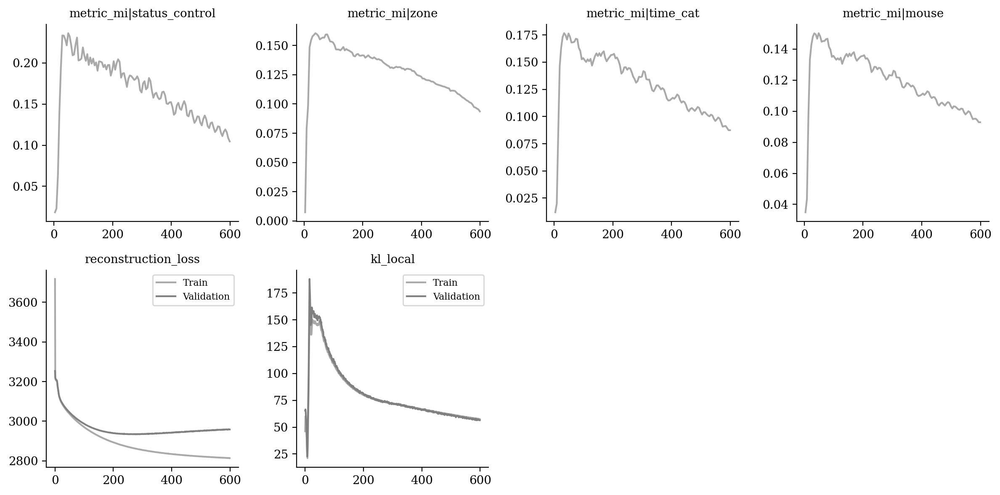

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

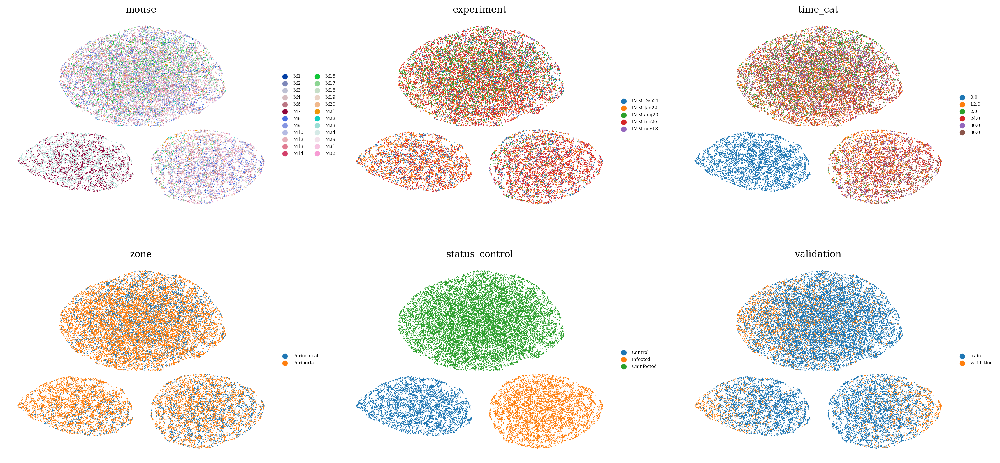

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

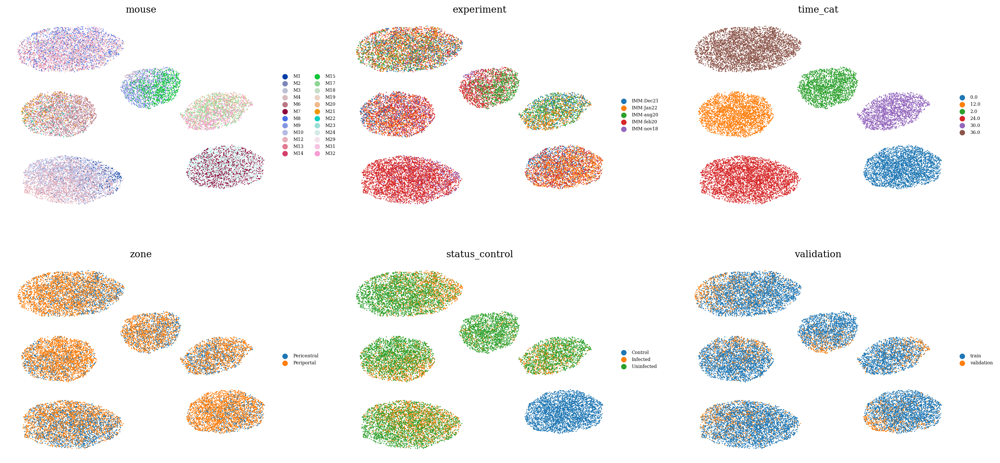

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

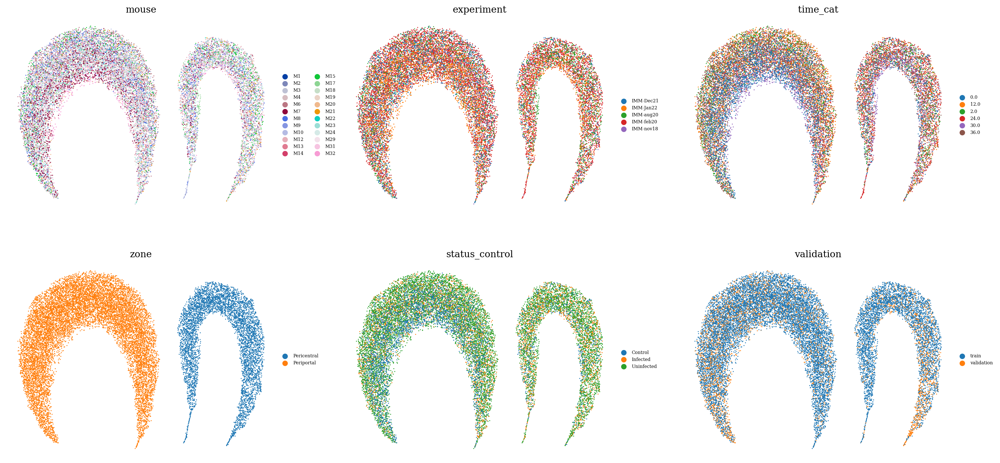

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

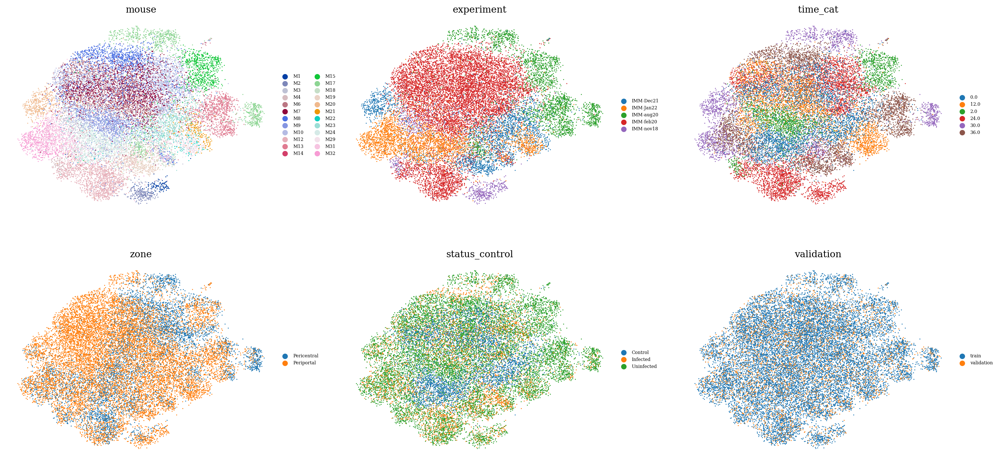

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

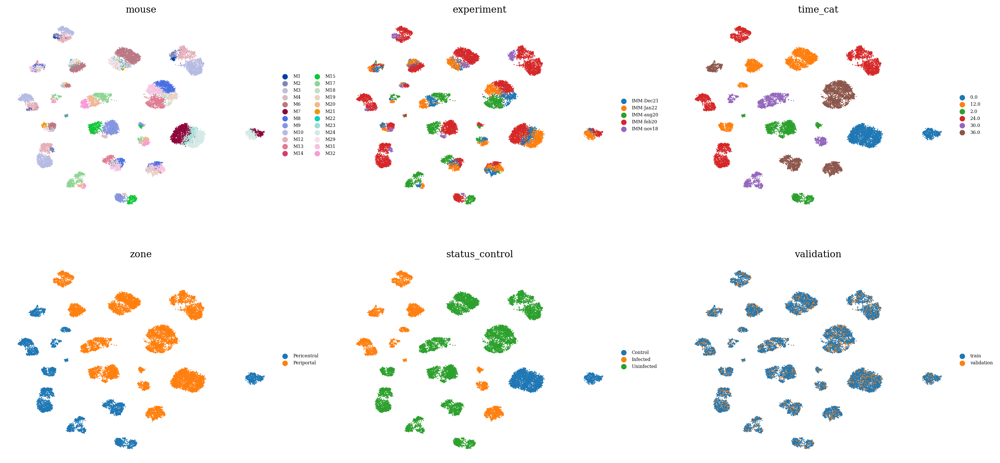

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

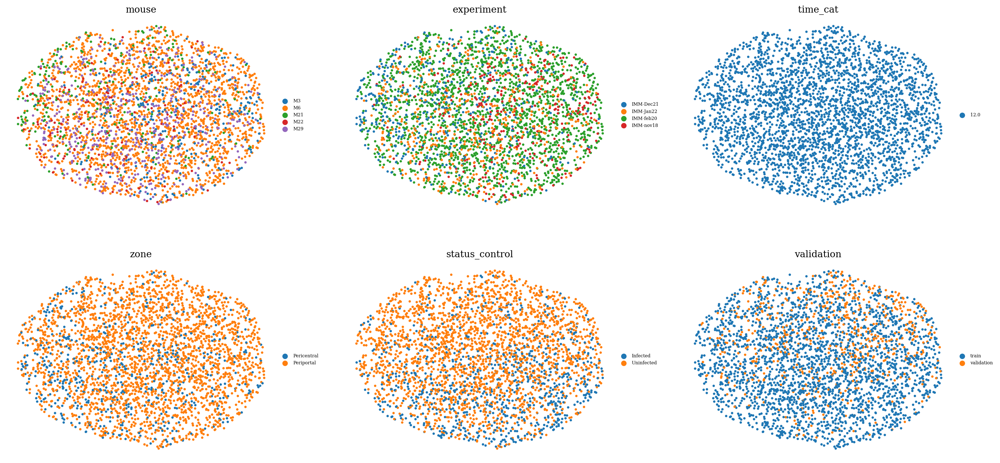

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )